**(1.MADDE) Organ bölgesinden TEK BİR HOG VEKTÖRÜ üretildi. Test işlemleri yapıldı. IoU skorları gösterildi.**

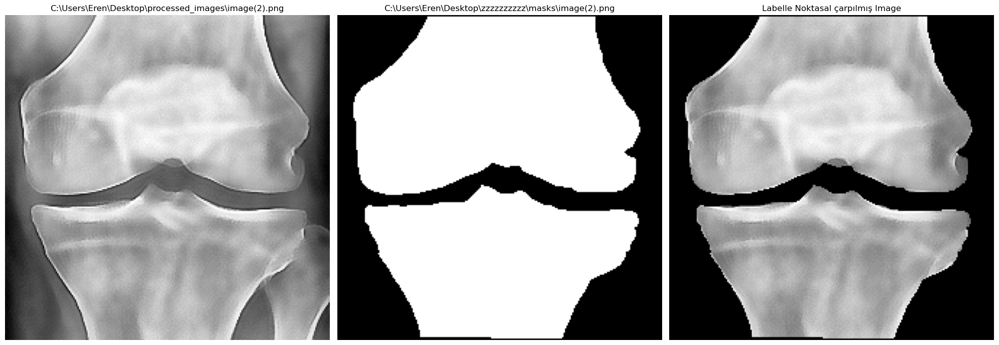

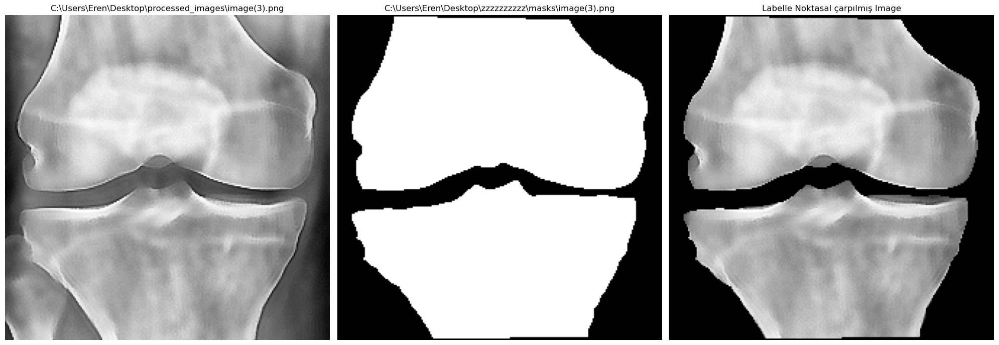

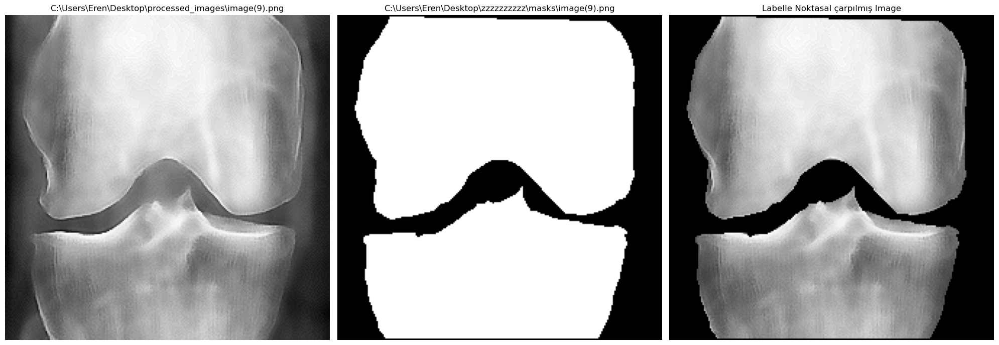

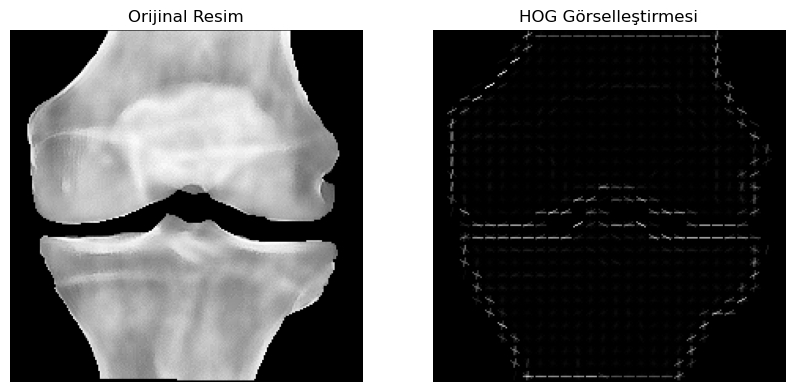

C:\Users\Eren\Desktop\processed_images\image(2).png  Çıkarılan Hog vektörü: 
HoG Vectors: [0.19458489 0.30622659 0.15096015 0.22907718 0.26303161 0.20371056
 0.14676011 0.30521765 0.08567601]
HoG Vectors Shape: 9


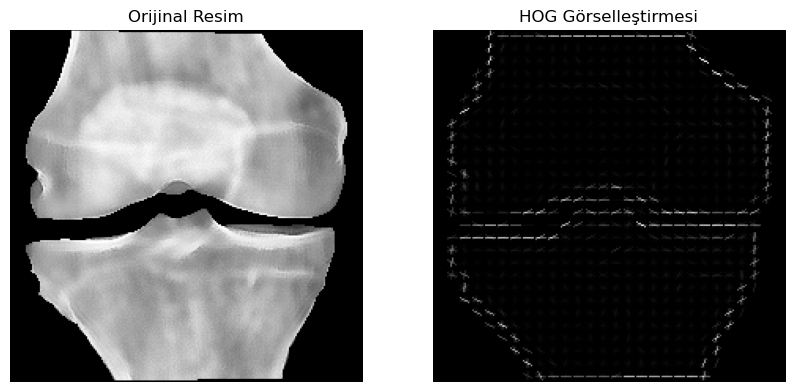

C:\Users\Eren\Desktop\processed_images\image(3).png  Çıkarılan Hog vektörü: 
HoG Vectors: [0.2193932  0.30510845 0.1718536  0.23513423 0.27988575 0.22018357
 0.15609492 0.30543826 0.13212789]
HoG Vectors Shape: 9


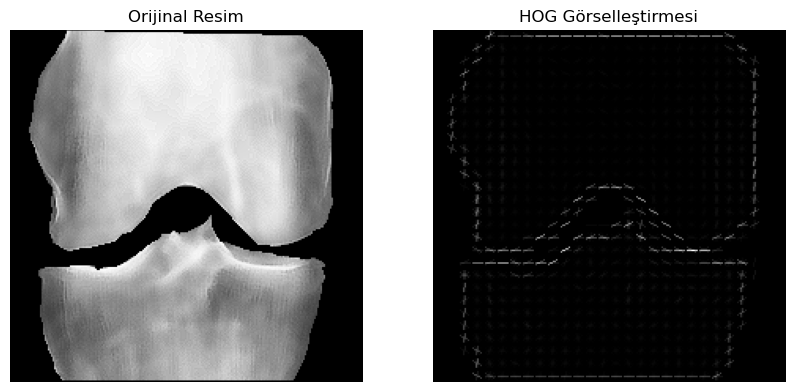

C:\Users\Eren\Desktop\processed_images\image(9).png  Çıkarılan Hog vektörü: 
HoG Vectors: [0.24048515 0.29783052 0.20469707 0.20215344 0.25038023 0.18857005
 0.22978868 0.3085478  0.15905603]
HoG Vectors Shape: 9
HOG vektörleri başarıyla 'C:/Users/Eren/Desktop/hog_vektor_kayit/tek_hog_vectors.pkl' konumuna kaydedildi.
Total HoG Vectors Shape: 3
Total HoG Vectors: [array([0.19458489, 0.30622659, 0.15096015, 0.22907718, 0.26303161,
       0.20371056, 0.14676011, 0.30521765, 0.08567601]), array([0.2193932 , 0.30510845, 0.1718536 , 0.23513423, 0.27988575,
       0.22018357, 0.15609492, 0.30543826, 0.13212789]), array([0.24048515, 0.29783052, 0.20469707, 0.20215344, 0.25038023,
       0.18857005, 0.22978868, 0.3085478 , 0.15905603])]


In [36]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
import pickle
import os

# Görüntü normalizasyon fonksiyonu
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

 
def extract_hog_features_combined(image, cells_per_region=(10, 10)):
    """
    Görüntü için HOG özelliklerini çıkarır ve yerel HOG vektörlerini birleştirir.

    Parameters:
        image (ndarray): Gri ölçekli görüntü.
        cells_per_region (tuple): Birleştirme için kaç hücrelik bölgelerin ele alınacağı (satır, sütun).

    Returns:
        combined_hog_features (ndarray): Birleştirilmiş HOG özellik vektörü.
    """
    # HOG özelliklerini çıkar
    hog_features, hog_image = hog(
        image,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(1, 1),
        block_norm='L2-Hys',
        visualize=True,
        transform_sqrt=True,
        feature_vector=False  # Özellikler lokal olarak alınsın
    )

    # Hücreleri gruplayarak özellikleri birleştirme
    cell_rows, cell_cols = hog_features.shape[:2]
    region_rows, region_cols = cells_per_region

    combined_hog_features = []

    # Yerel özellikleri belirli bölgelerden birleştir
    for i in range(0, cell_rows, region_rows):
        for j in range(0, cell_cols, region_cols):
            # Bölge içindeki HOG özelliklerini alın
            region_features = hog_features[
                i:i + region_rows,
                j:j + region_cols
            ].ravel()

            # Bölge özelliklerini birleştir (ortalama alınabilir)
            combined_hog_features.append(np.mean(region_features))

    combined_hog_features = np.array(combined_hog_features)

    # Sonuçları görselleştir
    plt.figure(figsize=(10, 5))

    # Orijinal resim
    plt.subplot(1, 2, 1)
    plt.title("Orijinal Resim")
    plt.imshow(image, cmap='gray')
    plt.axis("off")

    # HOG görselleştirmesi
    plt.subplot(1, 2, 2)
    plt.title("HOG Görselleştirmesi")
    plt.imshow(hog_image, cmap='gray')
    plt.axis("off")

    plt.show()

    return combined_hog_features



# HOG vektörlerini bir dosyaya kaydetme
def SaveHOGVectors(cohog_vectors, file_path):
    output_dir = os.path.dirname(file_path)
    os.makedirs(output_dir, exist_ok=True)  # Klasör yoksa oluştur
    with open(file_path, 'wb') as file:
        pickle.dump(cohog_vectors, file)
    print(f"HOG vektörleri başarıyla '{file_path}' konumuna kaydedildi.")

def GetImageLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    label = ConvertAndNormalize(label)

    # Label'i ikili (binary) maske haline getirme
    _, binary_label = cv2.threshold(label, 127, 1, cv2.THRESH_BINARY)

    # Noktasal çarpma işlemi
    masked_image = img * binary_label
    return masked_image ,img ,label

def DisplayImageAndLabel(imgStr, labelStr, maskimage):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    plt.figure(figsize=(20, 10))

    # Orijinal Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(img, cmap='gray')
    plt.title(imgStr)
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 3, 2)
    plt.imshow(label, cmap='gray')
    plt.title(labelStr)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(maskimage, cmap='gray')
    plt.title("Labelle Noktasal çarpılmış Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


# Ana akış
if __name__ == "__main__":
    # Çoklu görüntü ve etiket dosya yolları
    image_paths = [r"C:\Users\Eren\Desktop\processed_images\image(2).png", 
                   r"C:\Users\Eren\Desktop\processed_images\image(3).png",
                   r"C:\Users\Eren\Desktop\processed_images\image(9).png"]
    
    label_paths = [r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png", 
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png",
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png" ]

    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)
        DisplayImageAndLabel(img_path, label_path, maskedimg)

    all_hog_vectors = []
        
    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)
        
        #Her gorselde organ bolgesinden cohog vektoru uret
        hog_vectors = extract_hog_features_combined(maskedimg)

        all_hog_vectors.append(hog_vectors)
        print(img_path," Çıkarılan Hog vektörü: ")
        print("HoG Vectors:", hog_vectors)
        print("HoG Vectors Shape:", len(hog_vectors))
        
    
    # Tüm HOG vektörlerini bir dosyaya kaydet
    SaveHOGVectors(all_hog_vectors, "C:/Users/Eren/Desktop/hog_vektor_kayit/tek_hog_vectors.pkl")

    print("Total HoG Vectors Shape:", len(all_hog_vectors))
    print("Total HoG Vectors:", all_hog_vectors)


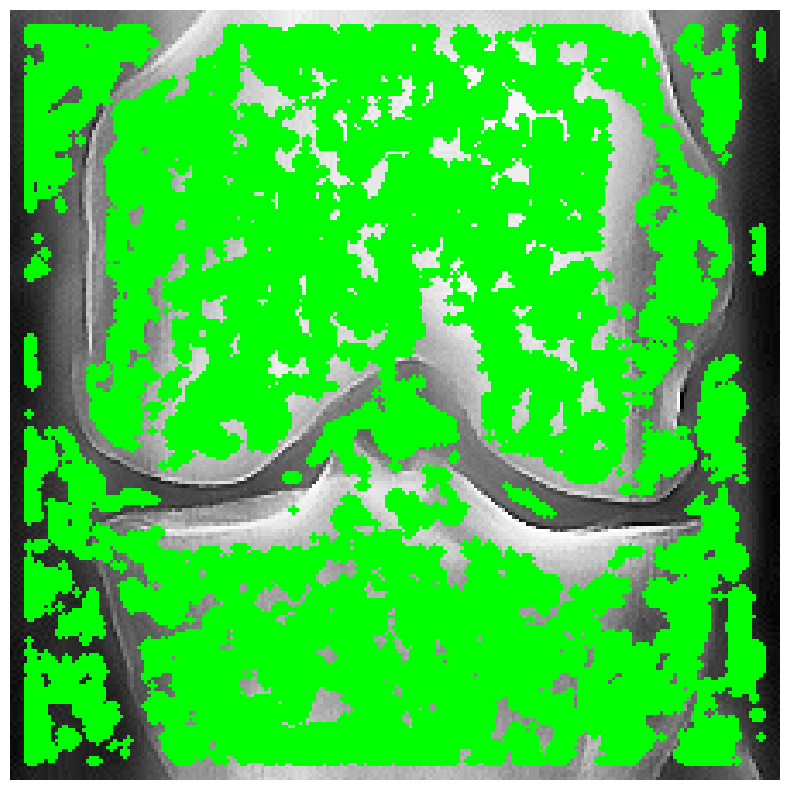

Total HOG Vectors Shape: 3
Total test patches extracted: 45796
Total matched patches: 21421


In [30]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
import pickle
from joblib import Parallel, delayed

def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)  # Her yamayı ayrı ayrı saklar

def NormalizeHOGVector(hog_vector):
    norm = np.linalg.norm(hog_vector)
    return hog_vector / norm if norm > 0 else hog_vector

def MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.001):
    matches = []
    for i, test_vector in enumerate(test_hog_vectors):
        for j, ref_vector in enumerate(hog_vectors):
            distance = np.linalg.norm(test_vector - ref_vector)
            if distance < threshold:  # Öklid uzaklığı eşik değeri
                matches.append(i)
                break
    return matches

def DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11):
    half_patch = patch_size // 2
    output_img = cv2.cvtColor(test_img, cv2.COLOR_GRAY2BGR)
    for idx in matched_indices:
        y, x = test_positions[idx]
        cv2.rectangle(output_img, (x - half_patch, y - half_patch), (x + half_patch, y + half_patch), (0, 255, 0), 2)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def LoadHOGVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    hog_vectors = LoadHOGVectors("C:/Users/Eren/Desktop/hog_vektor_kayit/tek_hog_vectors.pkl")

    # Test görüntüsü
    test_img_path = r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
    test_img = ConvertAndNormalize(test_img)

    # Test yamalarını oluştur (tüm görüntüde yamalar alınır)
    test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)

    # Test yamaları için HOG vektörleri oluştur
    test_hog_vectors = GenerateHOGVectors(test_patches)

    # Uyuşan yamaları bul
    matched_indices = MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.4)

    # Uyuşan yamaları test görüntüsünde işaretle
    DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=1)

    print("Total HOG Vectors Shape:", len(hog_vectors))
    print("Total test patches extracted:", len(test_patches))
    print("Total matched patches:", len(matched_indices))

Processing: C:\Users\Eren\Desktop\processed_images\image(4).png


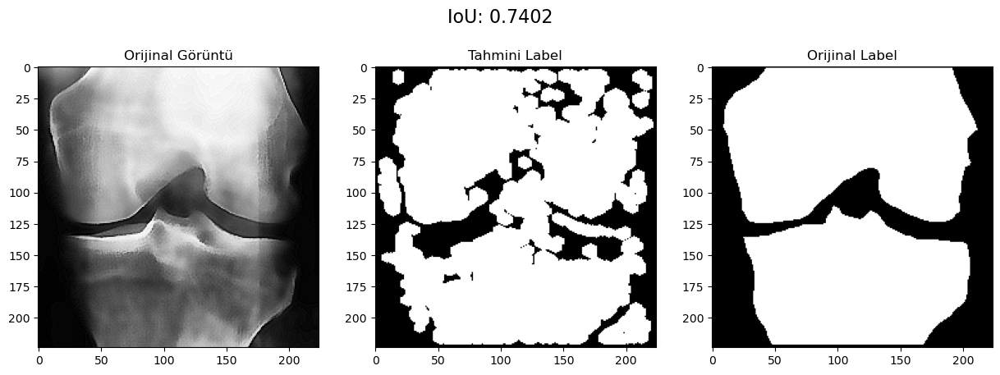

Processing: C:\Users\Eren\Desktop\processed_images\image(5).png


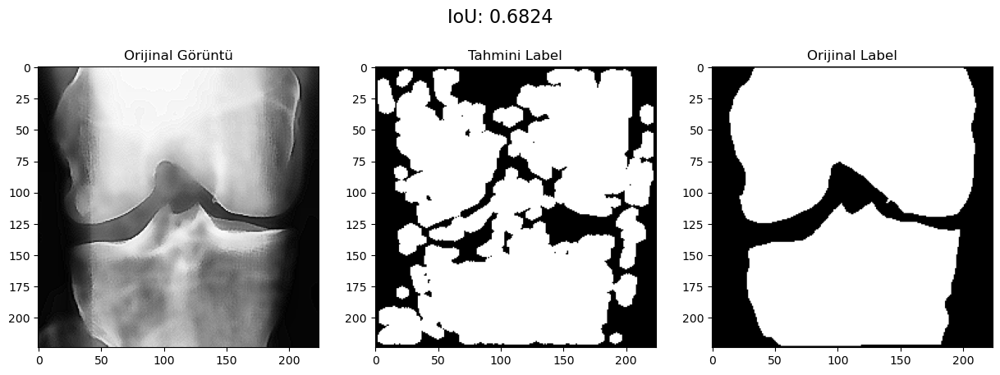

Processing: C:\Users\Eren\Desktop\processed_images\image(6).png


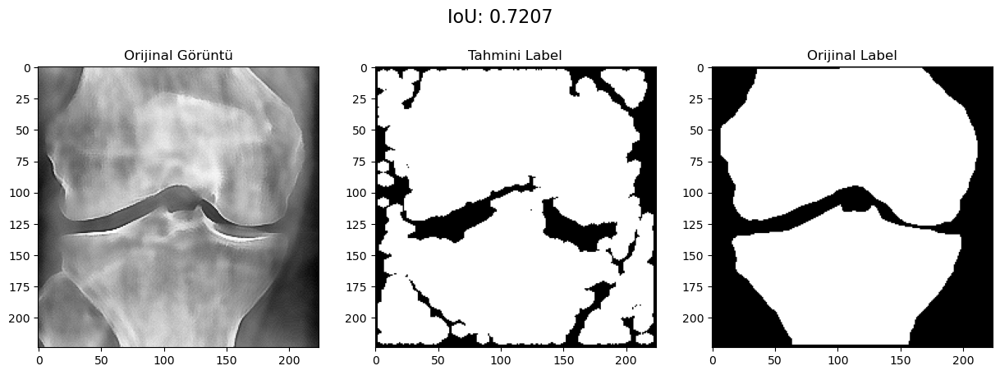

Processing: C:\Users\Eren\Desktop\processed_images\image(7).png


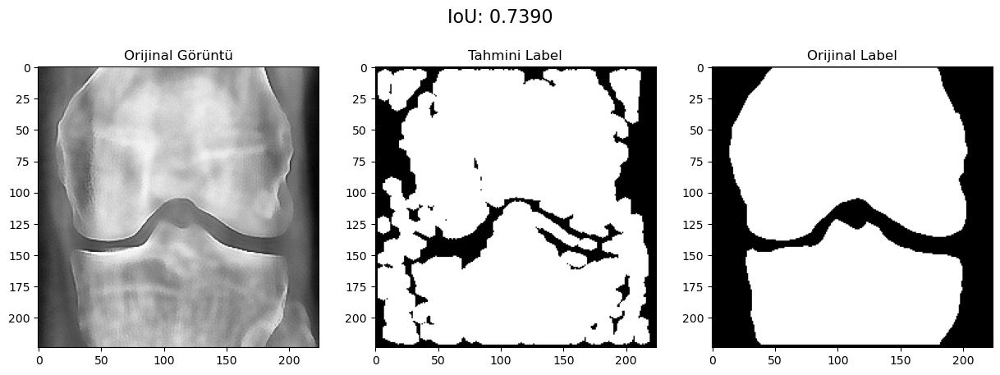

Processing: C:\Users\Eren\Desktop\processed_images\image(8).png


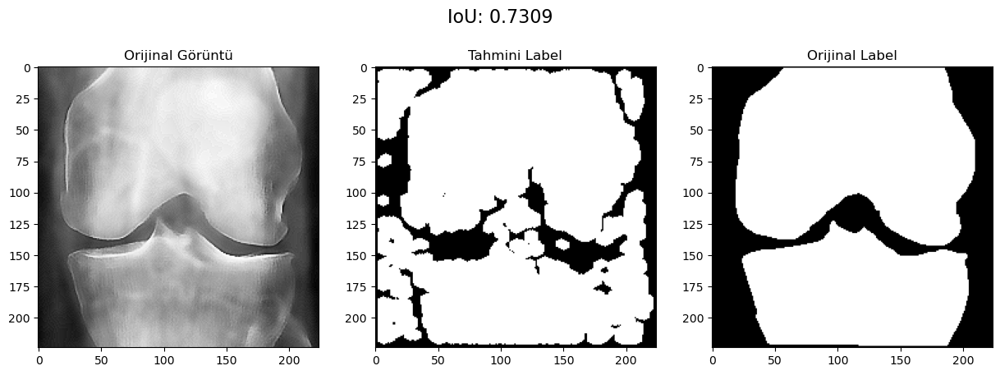

Ortalama IoU: 0.7227


In [34]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
from joblib import Parallel, delayed
import pickle

# Normalize ve gri tonlama işlemleri
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# Görüntüden yamalar çıkarma
def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

# HOG özellik vektörlerini çıkarma
def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

# Paralel HOG hesaplaması
def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)

# HOG vektör eşleşmelerini bulma
def MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.02):
    matches = []
    for i, test_vector in enumerate(test_hog_vectors):
        for ref_vector in hog_vectors:
            distance = np.linalg.norm(test_vector - ref_vector)
            if distance < threshold:
                matches.append(i)
                break
    return matches

# Delikleri doldurma
def fill_holes_with_contours(binary_mask):
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    filled_mask = np.zeros_like(binary_mask)
    for contour in contours:
        cv2.drawContours(filled_mask, [contour], -1, 255, thickness=cv2.FILLED)
    return filled_mask

# IoU hesaplama
def calculate_iou(mask1, mask2):
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    iou = intersection / union if union > 0 else 0
    return iou

# Özellik vektörlerini yükleme
def LoadFeatureVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ortalama IoU hesaplama
def calculate_average_iou(iou_values):
    if len(iou_values) == 0:
        return 0
    return sum(iou_values) / len(iou_values)
# Delikleri doldurma ve morfolojik işlemler uygulama
def refine_mask_with_morphology(binary_mask, kernel_size=5):
    # Yapılandırma elemanı (kernel) oluştur
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

    # Kapama işlemi (Closing: küçük boşlukları kapatır)
    closed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Açma işlemi (Opening: gürültüyü temizler)
    opened_mask = cv2.morphologyEx(closed_mask, cv2.MORPH_OPEN, kernel)

    # Dilasyon (Dilation: nesneleri genişletir)
    dilated_mask = cv2.dilate(opened_mask, kernel, iterations=1)

    return dilated_mask
# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    feature_vectors = LoadFeatureVectors("C:/Users/Eren/Desktop/hog_vektor_kayit/tek_hog_vectors.pkl")

    # Test görüntüleri ve etiket yolları
    test_image_paths = [
        r"C:\Users\Eren\Desktop\processed_images\image(4).png",
        r"C:\Users\Eren\Desktop\processed_images\image(5).png",
        r"C:\Users\Eren\Desktop\processed_images\image(6).png",
        r"C:\Users\Eren\Desktop\processed_images\image(7).png",
        r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    ]

    label_paths = [
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(4).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(5).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(6).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(7).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(8).png'
    ]

    iou_values = []

    for test_img_path, label_path in zip(test_image_paths, label_paths):
        print(f"Processing: {test_img_path}")

        test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
        test_img = ConvertAndNormalize(test_img)

        # Yamaları oluştur ve özellik vektörlerini çıkar
        test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)
        test_hog_vectors = GenerateHOGVectors(test_patches)

        # Eşleşen yamaları bul
        matched_indices = MatchHOGVectors(feature_vectors, test_hog_vectors, threshold=0.4)

        # İkili maske oluştur
        binary_mask = np.zeros(test_img.shape, dtype=np.uint8)
        for idx in matched_indices:
            y, x = test_positions[idx]
            cv2.circle(binary_mask, (x, y), 1, 255, -1)

        # Delikleri doldur ve morfolojik işlemler uygula
        filled_mask = fill_holes_with_contours(binary_mask)
        refined_mask = refine_mask_with_morphology(filled_mask)

        reference_label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

        if reference_label is None:
            raise FileNotFoundError(f"Referans label bulunamadı: {label_path}")

        # IoU hesapla
        iou = calculate_iou(refined_mask > 0, reference_label > 0)
        iou_values.append(iou)

        # Görselleştirme
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.title("Orijinal Görüntü")
        plt.imshow(test_img, cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title("Tahmini Label")
        plt.imshow(refined_mask, cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title("Orijinal Label")
        plt.imshow(reference_label, cmap='gray')

        plt.suptitle(f"IoU: {iou:.4f}", fontsize=16)
        plt.show()

    # Ortalama IoU hesapla ve yazdır
    average_iou = calculate_average_iou(iou_values)
    print(f"Ortalama IoU: {average_iou:.4f}")

**(4.MADDE) LABEL EROSİON İLE KÜÇÜLTÜLEREK her label pikseline karşılık gelen organ pikselinden patch alınıp kodllanarak karşılaştırılmasıyla oluşturulan desen kodlama adımı burda 2 farklı yöntem var birinde HER PATCH İÇİN VEKTÖRLER var diğerinde ise HOG VEKTÖR ORTALAMASI KULLANILARAK TEK  BİR VEKTÖR ile karşılaştırma yapılıyor**

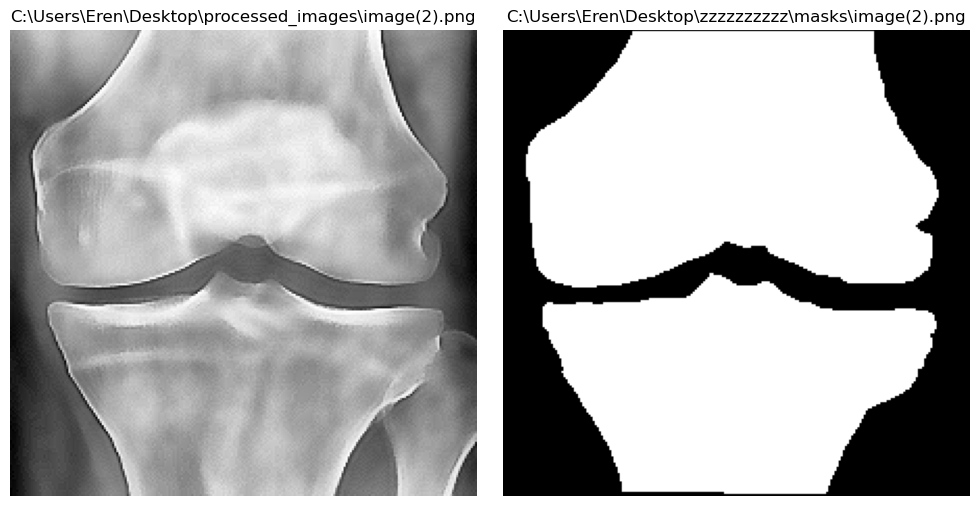

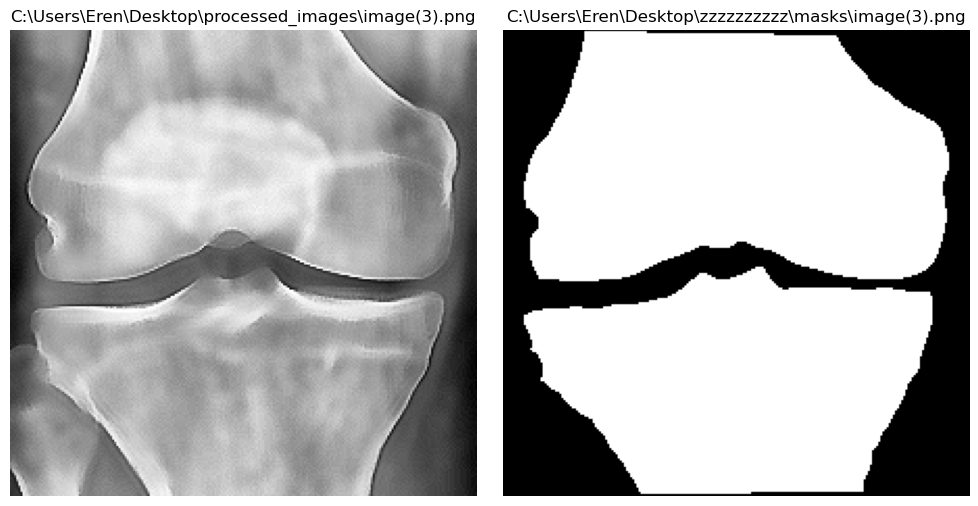

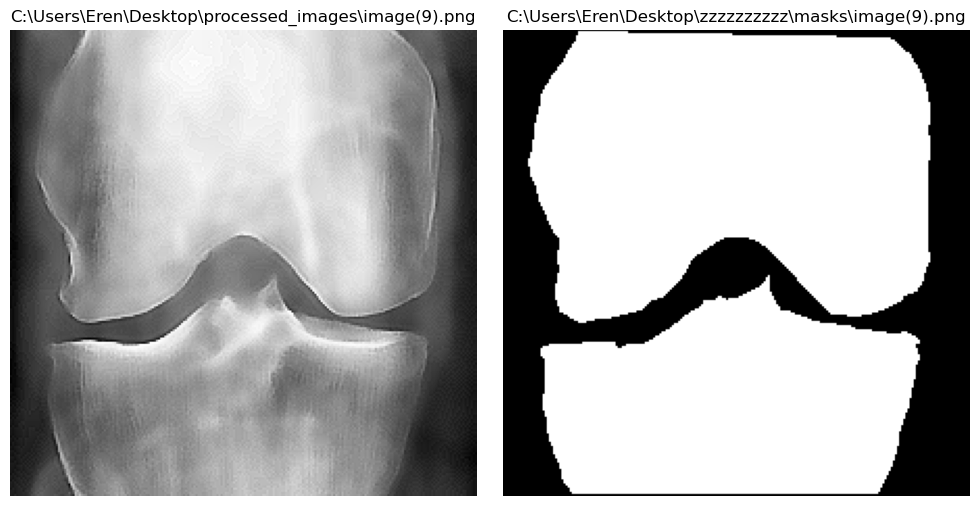

Processed C:\Users\Eren\Desktop\processed_images\image(2).png and C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png


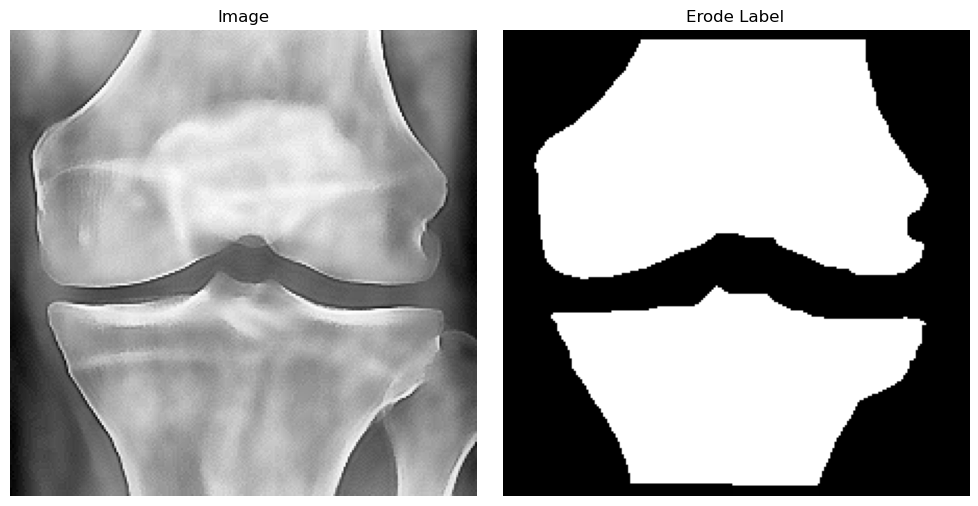

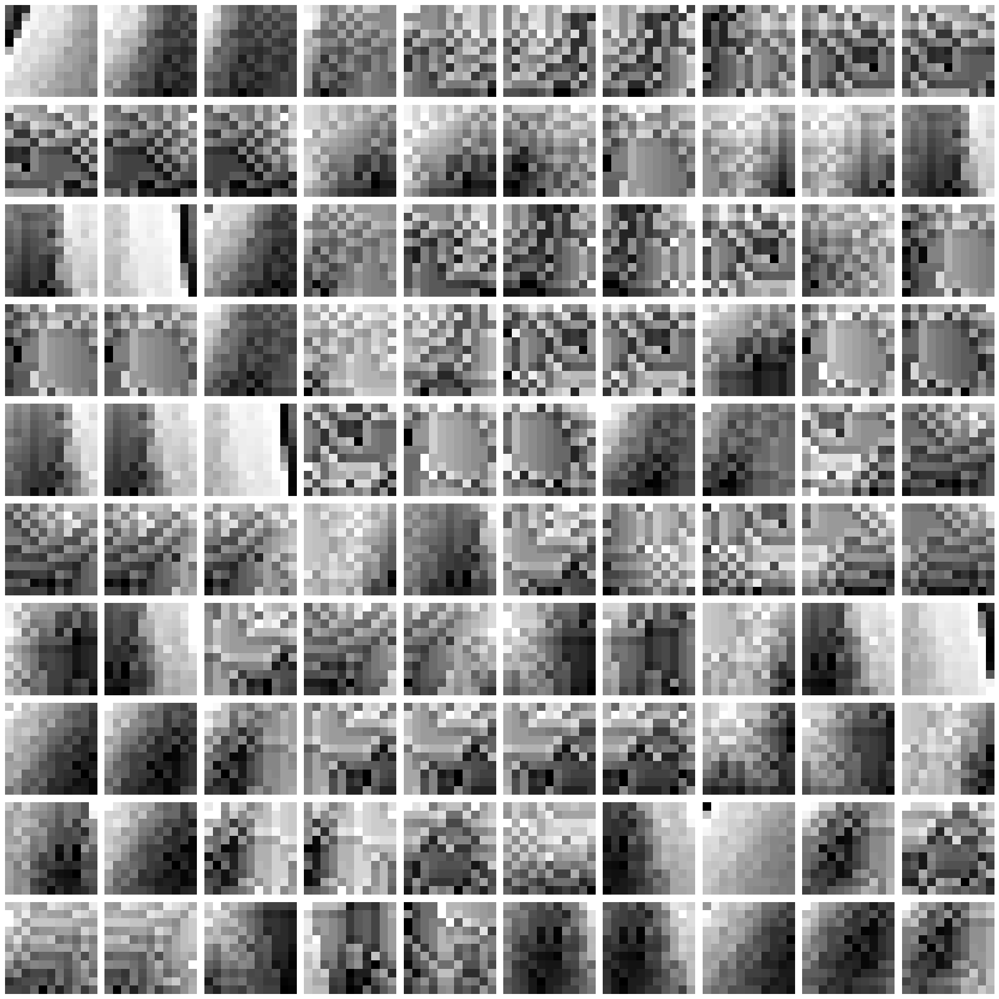

HOG vektörleri başarıyla 'C:/Users/Eren/Desktop/hog_vektor_kayit/hog_vectors_erosion.pkl' konumuna kaydedildi.
Total HOG Vectors Shape: 561
Total patches extracted: 28893
Total unique patches: 561
Processed C:\Users\Eren\Desktop\processed_images\image(3).png and C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png


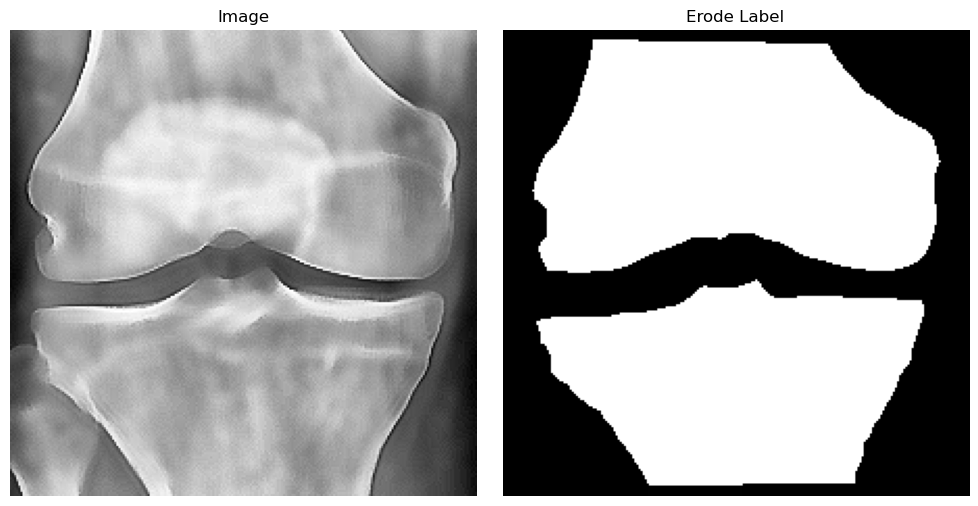

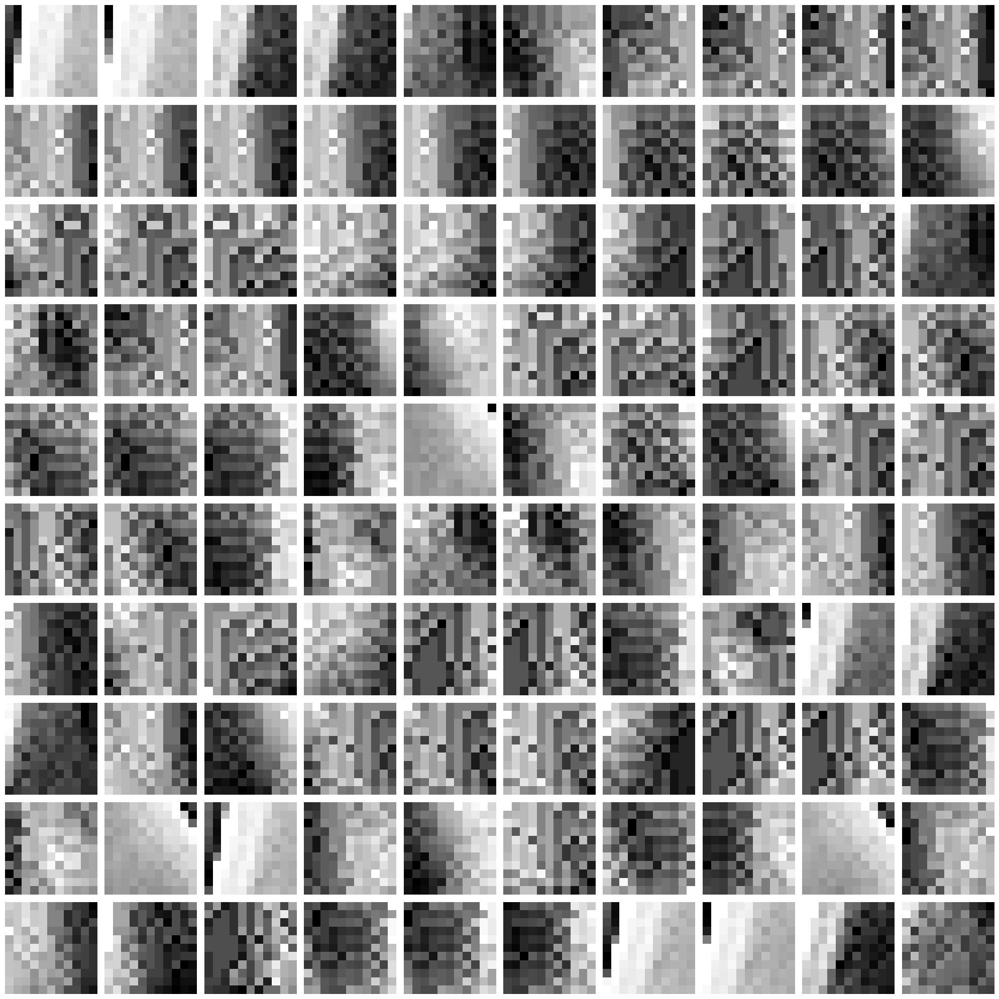

HOG vektörleri başarıyla 'C:/Users/Eren/Desktop/hog_vektor_kayit/hog_vectors_erosion.pkl' konumuna kaydedildi.
Total HOG Vectors Shape: 641
Total patches extracted: 31067
Total unique patches: 641
Processed C:\Users\Eren\Desktop\processed_images\image(9).png and C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png


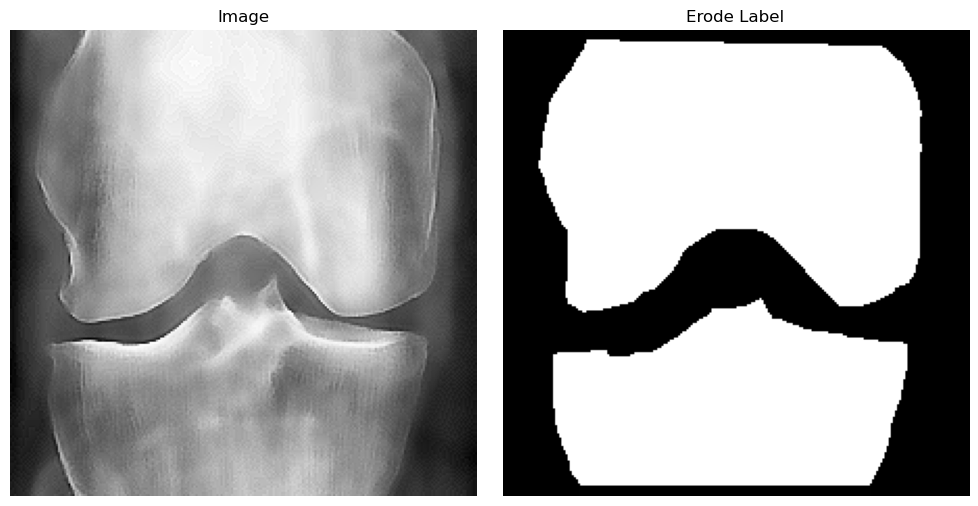

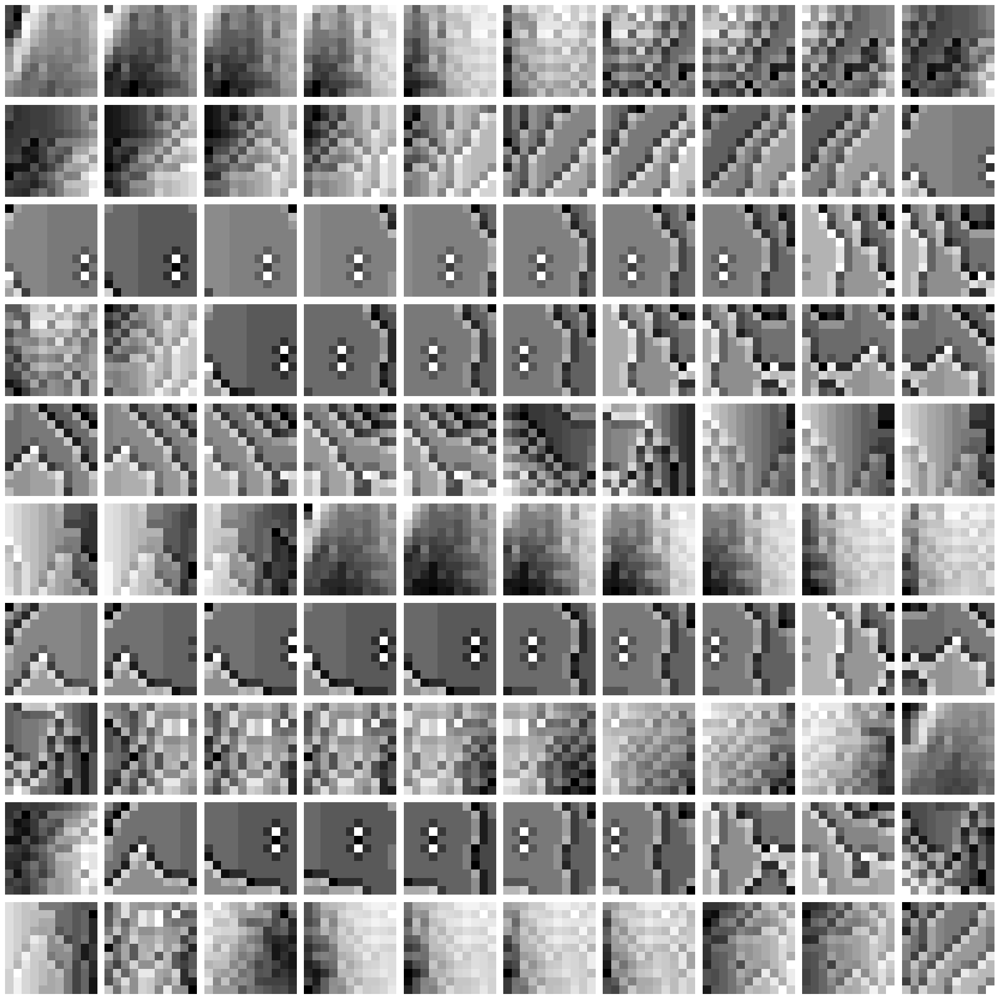

HOG vektörleri başarıyla 'C:/Users/Eren/Desktop/hog_vektor_kayit/hog_vectors_erosion.pkl' konumuna kaydedildi.
Total HOG Vectors Shape: 789
Total patches extracted: 31835
Total unique patches: 789


In [1]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
from skimage import measure
import math
import pickle
from joblib import Parallel, delayed
import os

def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

def ApplyErosion(label, kernel_size=3):
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    eroded_label = cv2.erode(label, kernel, iterations=4)
    return eroded_label

def GetImageLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    label = ConvertAndNormalize(label)
    label = ApplyErosion(label, kernel_size=3)
    return img, label

def GetPatchesFromLabel(img, label, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, label.shape[0] - half_patch, step_size):
        for x in range(half_patch, label.shape[1] - half_patch, step_size):
            if label[y, x] > 0:
                patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
                patches.append(patch)
                positions.append((y, x))
    return patches, positions

def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)

def FindUniquePatchesUsingHOG(hog_vectors, threshold=0.1):
    unique_indices = []
    for i, vector in enumerate(hog_vectors):
        is_unique = True
        for j in unique_indices:
            if np.linalg.norm(vector - hog_vectors[j]) < threshold:
                is_unique = False
                break
        if is_unique:
            unique_indices.append(i)
    return unique_indices

def DisplayPatches(patches, max_cols=10, max_patches=100):
    num_patches = min(len(patches), max_patches)
    cols = min(max_cols, num_patches)
    rows = math.ceil(num_patches / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(patches[i], cmap='gray')
            ax.axis('off')
        else:
            ax.axis('off')
    plt.tight_layout()
    plt.show()

def SaveHOGVectors(hog_vectors, file_path):
    output_dir = os.path.dirname(file_path)
    os.makedirs(output_dir, exist_ok=True)
    if os.path.exists(file_path):
        with open(file_path, 'rb') as file:
            existing_vectors = pickle.load(file)
        hog_vectors = np.vstack((existing_vectors, hog_vectors))
    with open(file_path, 'wb') as file:
        pickle.dump(hog_vectors, file)

    print(f"HOG vektörleri başarıyla '{file_path}' konumuna kaydedildi.")

def DisplayImageAndLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    plt.figure(figsize=(10, 5))

    # Orijinal Görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.title(imgStr)
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 2, 2)
    plt.imshow(label, cmap='gray')
    plt.title(labelStr)
    plt.axis("off")

    plt.tight_layout()
    plt.show()
    
def DisplayErosion(img, label):
    
    plt.figure(figsize=(10, 5))

    # Orijinal Görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.title("Image")
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 2, 2)
    plt.imshow(label, cmap='gray')
    plt.title("Erode Label")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_label_pairs = [
        (r"C:\Users\Eren\Desktop\processed_images\image(2).png", r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png"),
        (r"C:\Users\Eren\Desktop\processed_images\image(3).png", r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png"),
        (r"C:\Users\Eren\Desktop\processed_images\image(9).png", r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png")
    ]
    for img_path, label_path in image_label_pairs:
        # Görüntü ve labeli yan yana göster
        DisplayImageAndLabel(img_path, label_path)
        
    output_path = "C:/Users/Eren/Desktop/hog_vektor_kayit/hog_vectors_erosion.pkl"

    for img_path, label_path in image_label_pairs:
        img, label = GetImageLabel(img_path, label_path)

        patches, positions = GetPatchesFromLabel(img, label, patch_size=11, step_size=1)

        hog_vectors = GenerateHOGVectors(patches)

        unique_indices = FindUniquePatchesUsingHOG(hog_vectors, threshold=0.2)
        unique_patches = [patches[i] for i in unique_indices]
        unique_hog_vectors = [hog_vectors[i] for i in unique_indices]

        
        
        print(f"Processed {img_path} and {label_path}")
        DisplayErosion(img, label)
        DisplayPatches(unique_patches, max_patches=100)
        
        SaveHOGVectors(unique_hog_vectors, output_path)

        
        print("Total HOG Vectors Shape:", len(unique_hog_vectors))
        print("Total patches extracted:", len(patches))
        print("Total unique patches:", len(unique_patches))


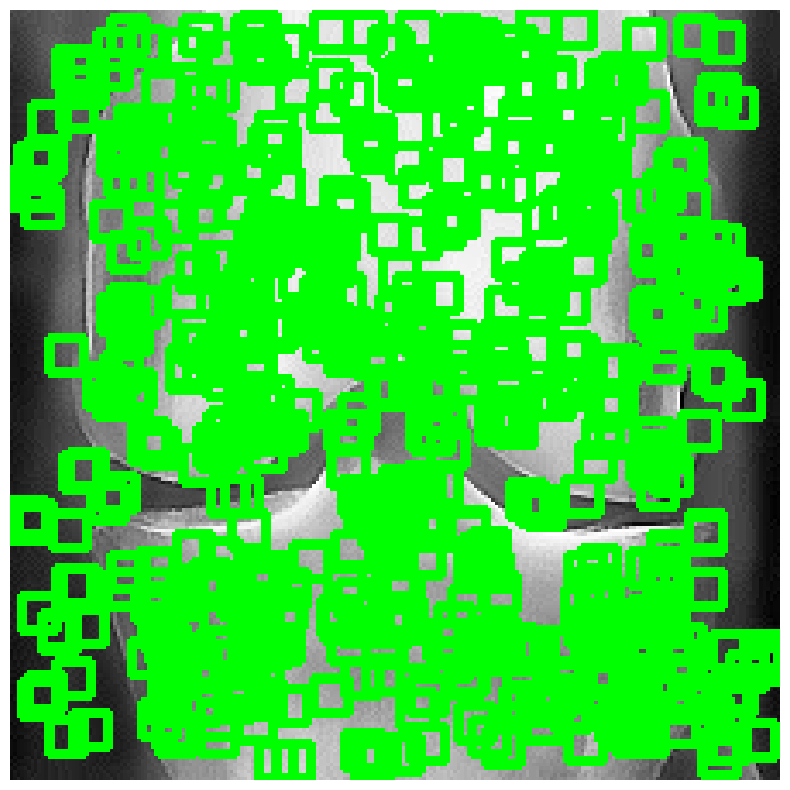

Total HOG Vectors Shape: 1991
Total test patches extracted: 45796
Total matched patches: 660


In [14]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
import pickle
from joblib import Parallel, delayed

def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)  # Her yamayı ayrı ayrı saklar

def NormalizeHOGVector(hog_vector):
    norm = np.linalg.norm(hog_vector)
    return hog_vector / norm if norm > 0 else hog_vector

def MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.001):
    matches = []
    for i, test_vector in enumerate(test_hog_vectors):
        for j, ref_vector in enumerate(hog_vectors):
            distance = np.linalg.norm(test_vector - ref_vector)
            if distance < threshold:  # Öklid uzaklığı eşik değeri
                matches.append(i)
                break
    return matches

def DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11):
    half_patch = patch_size // 2
    output_img = cv2.cvtColor(test_img, cv2.COLOR_GRAY2BGR)
    for idx in matched_indices:
        y, x = test_positions[idx]
        cv2.rectangle(output_img, (x - half_patch, y - half_patch), (x + half_patch, y + half_patch), (0, 255, 0), 2)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def LoadHOGVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    hog_vectors = LoadHOGVectors("C:/Users/Eren/Desktop/hog_vektor_kayit/hog_vectors_erosion.pkl")

    # Test görüntüsü
    test_img_path = r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
    test_img = ConvertAndNormalize(test_img)

    # Test yamalarını oluştur (tüm görüntüde yamalar alınır)
    test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)

    # Test yamaları için HOG vektörleri oluştur
    test_hog_vectors = GenerateHOGVectors(test_patches)

    # Uyuşan yamaları bul
    matched_indices = MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.038)

    # Uyuşan yamaları test görüntüsünde işaretle
    DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11)

    print("Total HOG Vectors Shape:", len(hog_vectors))
    print("Total test patches extracted:", len(test_patches))
    print("Total matched patches:", len(matched_indices))

Processing: C:\Users\Eren\Desktop\processed_images\image(4).png


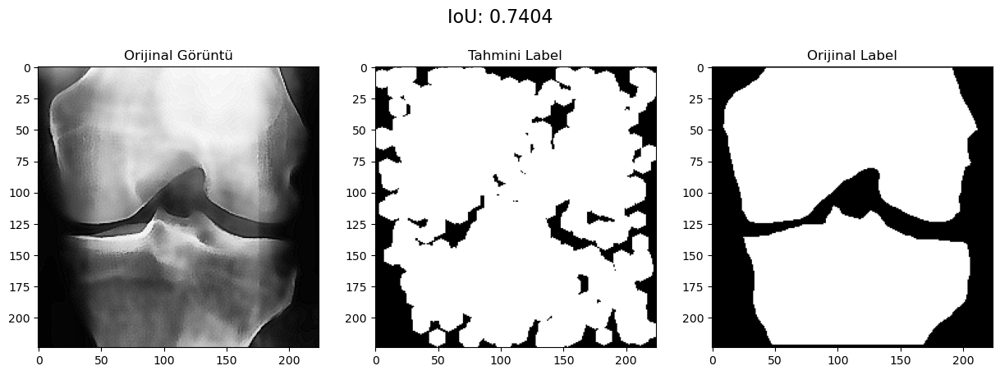

Processing: C:\Users\Eren\Desktop\processed_images\image(5).png


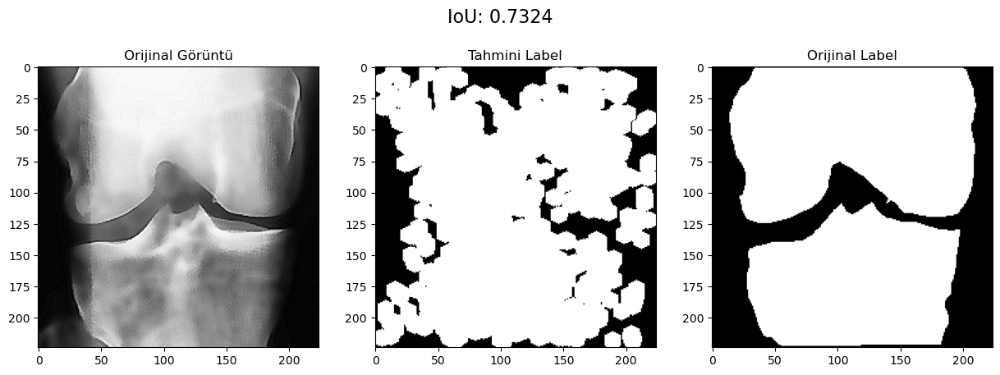

Processing: C:\Users\Eren\Desktop\processed_images\image(6).png


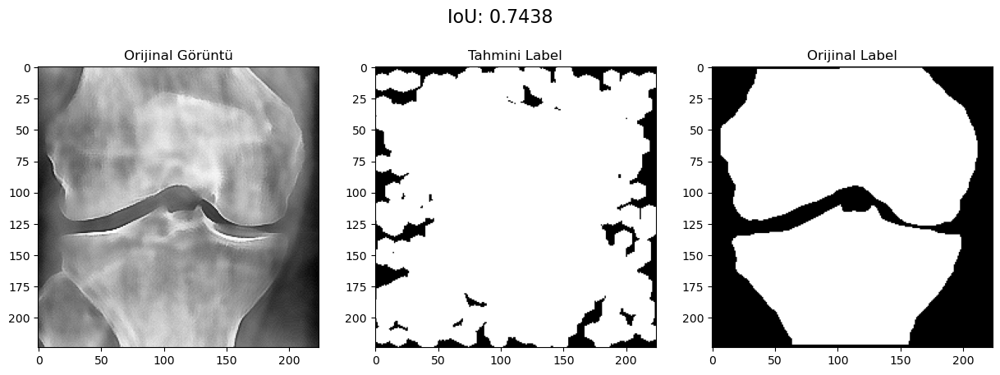

Processing: C:\Users\Eren\Desktop\processed_images\image(7).png


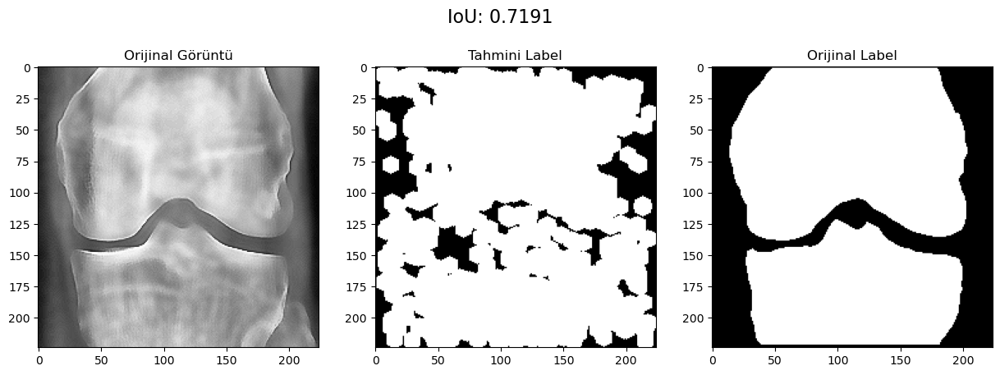

Processing: C:\Users\Eren\Desktop\processed_images\image(8).png


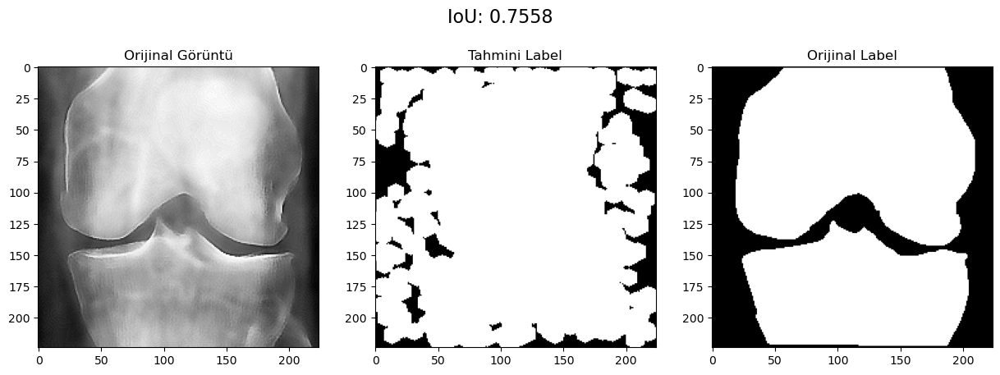

Ortalama IoU: 0.7383


In [6]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
from joblib import Parallel, delayed
import pickle

# Normalize ve gri tonlama işlemleri
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# Görüntüden yamalar çıkarma
def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

# HOG özellik vektörlerini çıkarma
def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

# Paralel HOG hesaplaması
def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)

# HOG vektör eşleşmelerini bulma
def MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.02):
    matches = []
    for i, test_vector in enumerate(test_hog_vectors):
        for ref_vector in hog_vectors:
            distance = np.linalg.norm(test_vector - ref_vector)
            if distance < threshold:
                matches.append(i)
                break
    return matches

# Delikleri doldurma
def fill_holes_with_contours(binary_mask):
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    filled_mask = np.zeros_like(binary_mask)
    for contour in contours:
        cv2.drawContours(filled_mask, [contour], -1, 255, thickness=cv2.FILLED)
    return filled_mask

# IoU hesaplama
def calculate_iou(mask1, mask2):
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    iou = intersection / union if union > 0 else 0
    return iou

# Özellik vektörlerini yükleme
def LoadFeatureVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ortalama IoU hesaplama
def calculate_average_iou(iou_values):
    if len(iou_values) == 0:
        return 0
    return sum(iou_values) / len(iou_values)
# Delikleri doldurma ve morfolojik işlemler uygulama
def refine_mask_with_morphology(binary_mask, kernel_size=5):
    # Yapılandırma elemanı (kernel) oluştur
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

    # Kapama işlemi (Closing: küçük boşlukları kapatır)
    closed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Açma işlemi (Opening: gürültüyü temizler)
    opened_mask = cv2.morphologyEx(closed_mask, cv2.MORPH_OPEN, kernel)

    # Dilasyon (Dilation: nesneleri genişletir)
    dilated_mask = cv2.dilate(opened_mask, kernel, iterations=1)

    return dilated_mask
# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    feature_vectors = LoadFeatureVectors("C:/Users/Eren/Desktop/hog_vektor_kayit/hog_vectors_erosion.pkl")

    # Test görüntüleri ve etiket yolları
    test_image_paths = [
        r"C:\Users\Eren\Desktop\processed_images\image(4).png",
        r"C:\Users\Eren\Desktop\processed_images\image(5).png",
        r"C:\Users\Eren\Desktop\processed_images\image(6).png",
        r"C:\Users\Eren\Desktop\processed_images\image(7).png",
        r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    ]

    label_paths = [
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(4).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(5).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(6).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(7).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(8).png'
    ]

    iou_values = []

    for test_img_path, label_path in zip(test_image_paths, label_paths):
        print(f"Processing: {test_img_path}")

        test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
        test_img = ConvertAndNormalize(test_img)

        # Yamaları oluştur ve özellik vektörlerini çıkar
        test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)
        test_hog_vectors = GenerateHOGVectors(test_patches)

        # Eşleşen yamaları bul
        matched_indices = MatchHOGVectors(feature_vectors, test_hog_vectors, threshold=0.045)

        # İkili maske oluştur
        binary_mask = np.zeros(test_img.shape, dtype=np.uint8)
        for idx in matched_indices:
            y, x = test_positions[idx]
            cv2.circle(binary_mask, (x, y), 5, 255, -1)

        # Delikleri doldur ve morfolojik işlemler uygula
        filled_mask = fill_holes_with_contours(binary_mask)
        refined_mask = refine_mask_with_morphology(filled_mask)

        reference_label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

        if reference_label is None:
            raise FileNotFoundError(f"Referans label bulunamadı: {label_path}")

        # IoU hesapla
        iou = calculate_iou(refined_mask > 0, reference_label > 0)
        iou_values.append(iou)

        # Görselleştirme
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.title("Orijinal Görüntü")
        plt.imshow(test_img, cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title("Tahmini Label")
        plt.imshow(refined_mask, cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title("Orijinal Label")
        plt.imshow(reference_label, cmap='gray')

        plt.suptitle(f"IoU: {iou:.4f}", fontsize=16)
        plt.show()

    # Ortalama IoU hesapla ve yazdır
    average_iou = calculate_average_iou(iou_values)
    print(f"Ortalama IoU: {average_iou:.4f}")


2.YÖNTEM HOG VEKTÖR ORTALAMASI KULLANILARAK yapılan desen kodlama.

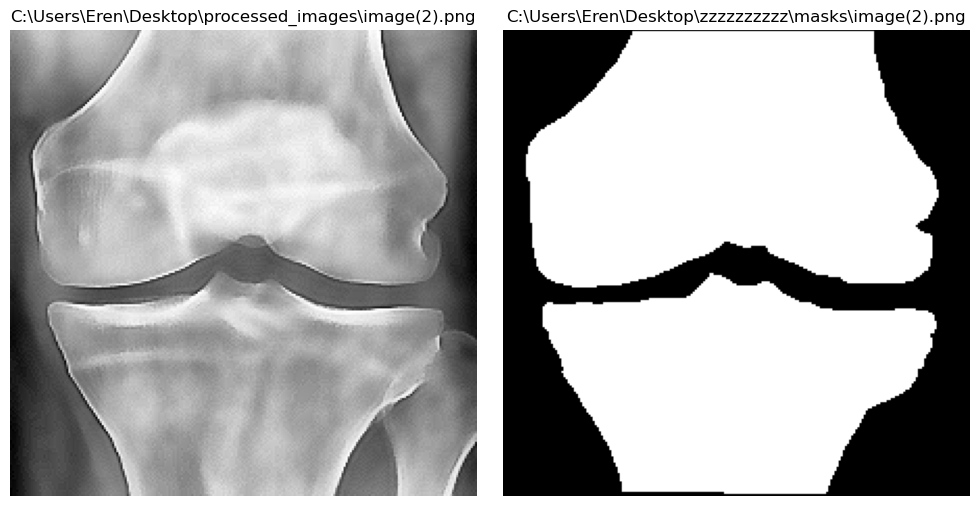

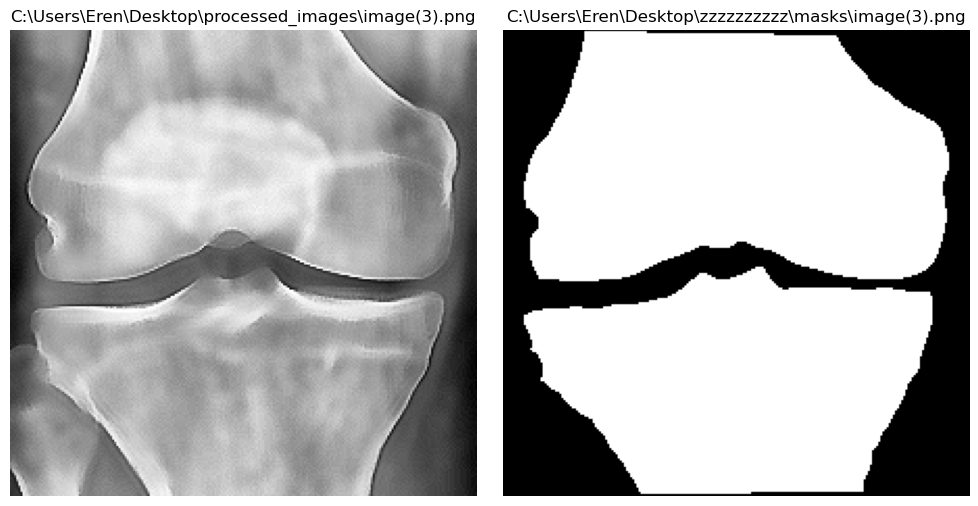

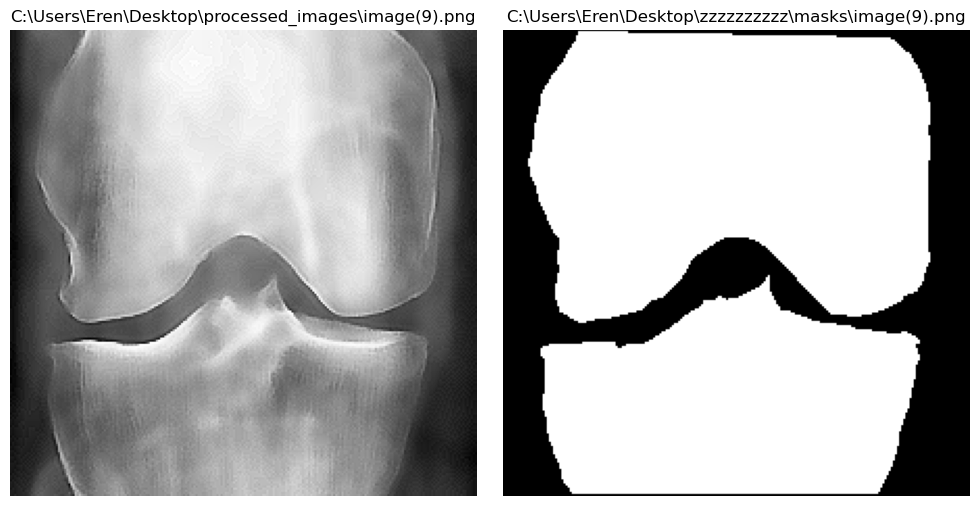

Processed C:\Users\Eren\Desktop\processed_images\image(2).png and C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png


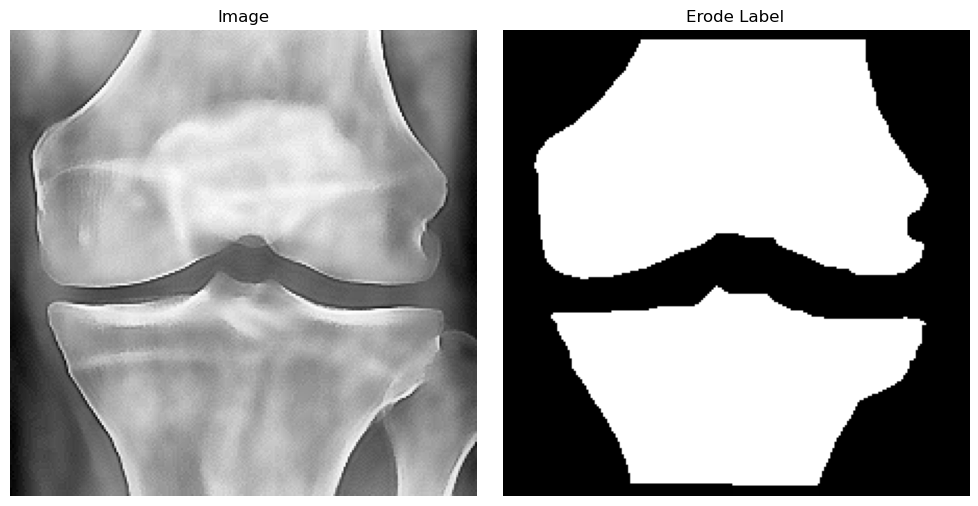

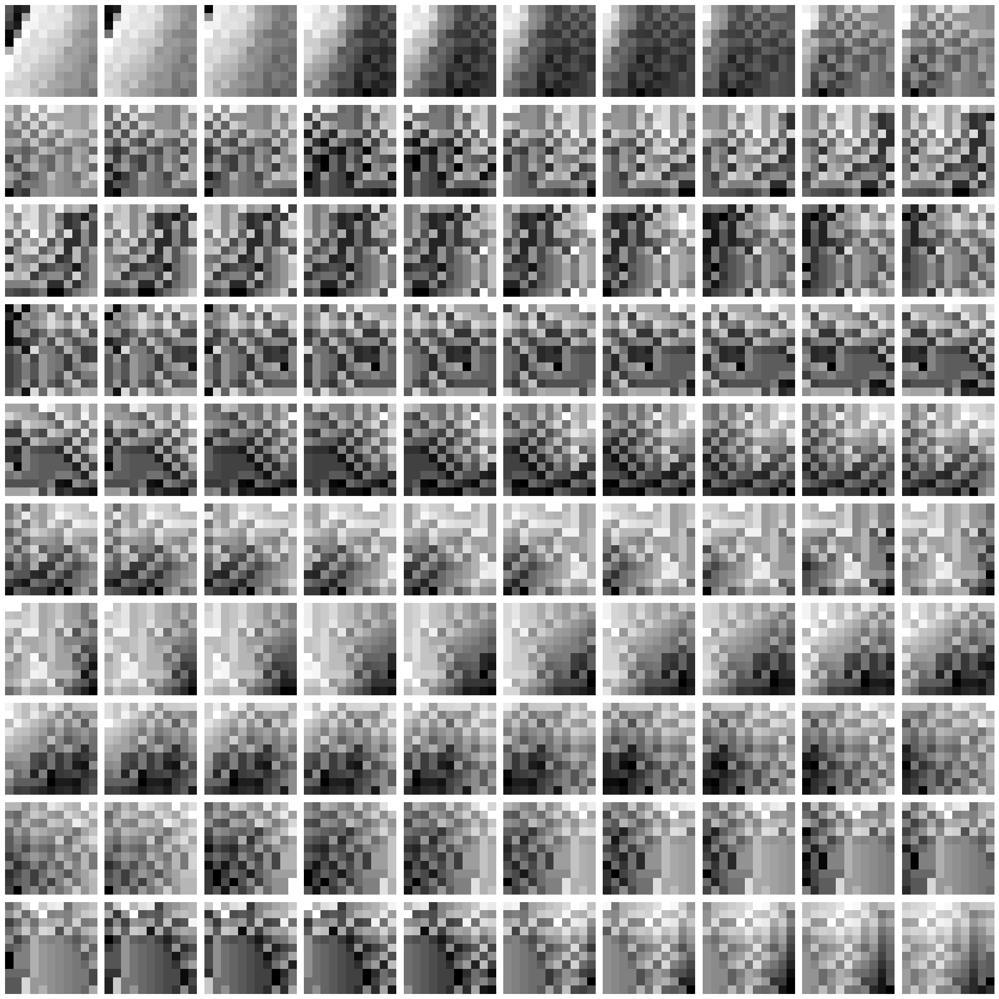

Total patches extracted: 28893
Total HOG vectors:  [[0.48778662 0.48778662 0.48778662 ... 0.03217925 0.13906479 0.12443187]
 [0.47726086 0.47726086 0.47726086 ... 0.04187826 0.09574376 0.23867949]
 [0.4810194  0.4810194  0.4810194  ... 0.02816782 0.1611484  0.10223434]
 ...
 [0.41680319 0.41680319 0.41680319 ... 0.11663736 0.31914107 0.05617677]
 [0.42086985 0.42086985 0.42086985 ... 0.10881403 0.29773504 0.05240877]
 [0.4179463  0.4179463  0.4179463  ... 0.11607578 0.29049953 0.12688228]]
Average HOG vectors:  [0.37226562 0.3019123  0.30860625 0.31177138 0.38019035 0.30355193
 0.30196691 0.29807821 0.26259665]
Processed C:\Users\Eren\Desktop\processed_images\image(3).png and C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png


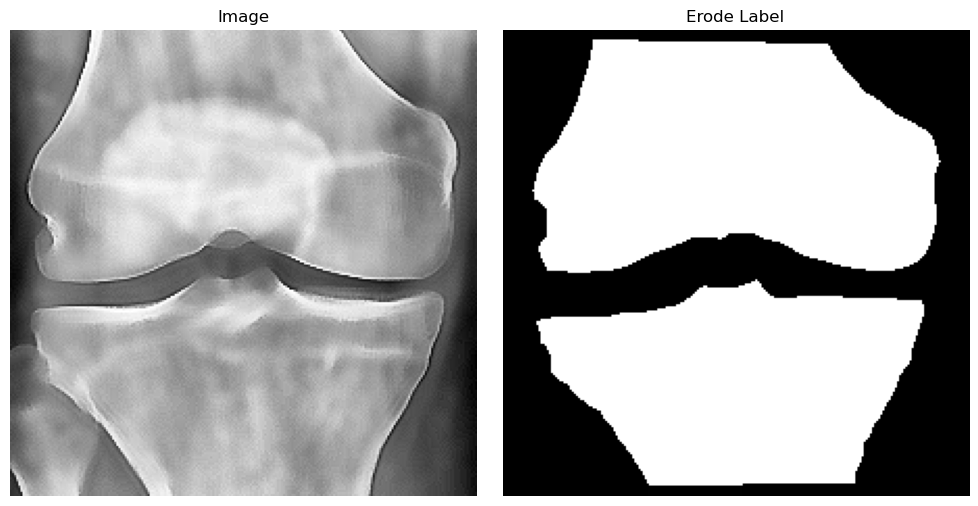

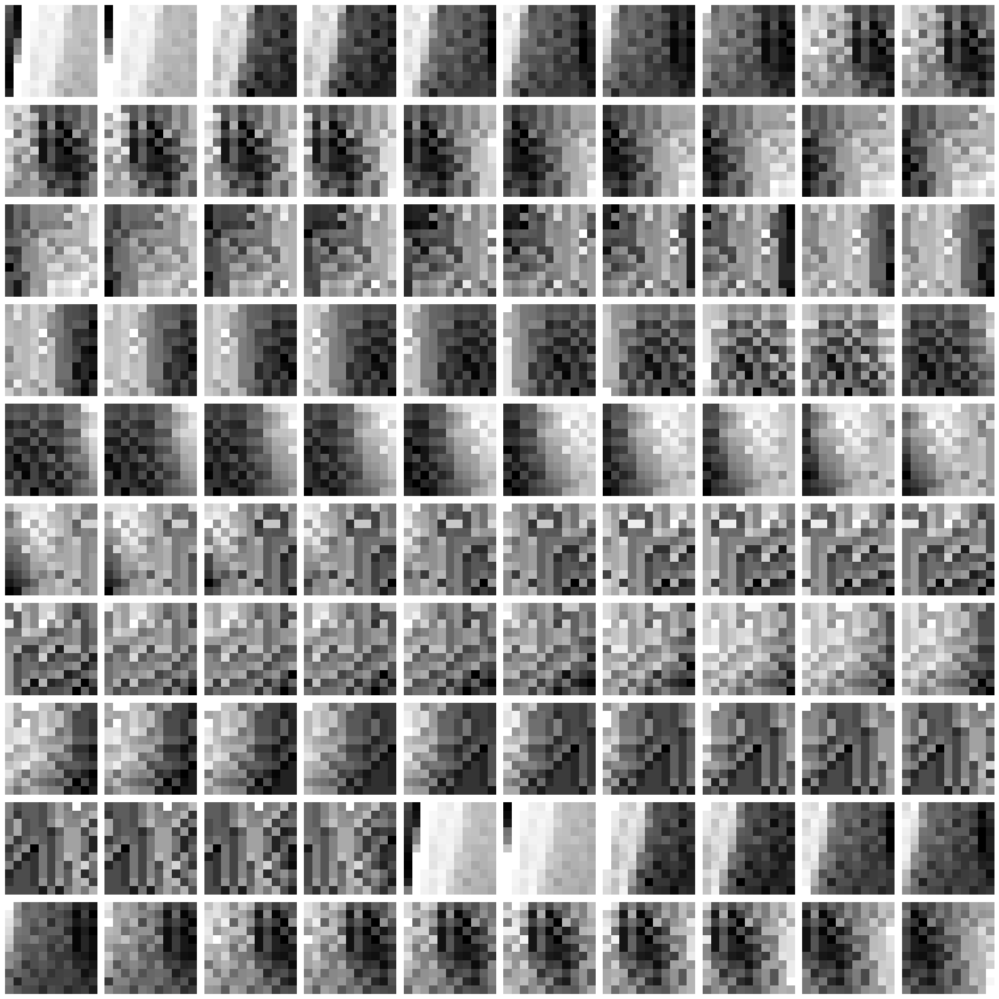

Total patches extracted: 31067
Total HOG vectors:  [[0.67793631 0.67793631 0.03353626 ... 0.         0.0365415  0.19049546]
 [0.57985964 0.47222021 0.05879385 ... 0.         0.10154272 0.30046096]
 [0.53111028 0.53111028 0.14640957 ... 0.09495001 0.27148414 0.53111028]
 ...
 [0.48308562 0.48308562 0.48308562 ... 0.09812346 0.11227503 0.26623425]
 [0.47758133 0.47758133 0.47758133 ... 0.09691123 0.12038519 0.26294517]
 [0.49448025 0.49448025 0.49448025 ... 0.09661907 0.12002226 0.16869478]]
Average HOG vectors:  [0.36953224 0.29611895 0.29761168 0.30787176 0.37989713 0.31185764
 0.30811284 0.30286459 0.26777441]
Processed C:\Users\Eren\Desktop\processed_images\image(9).png and C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png


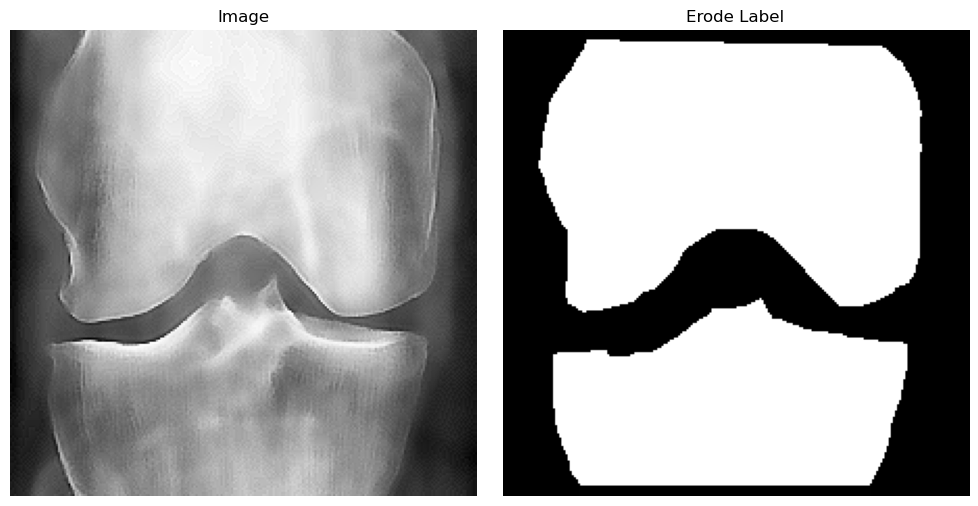

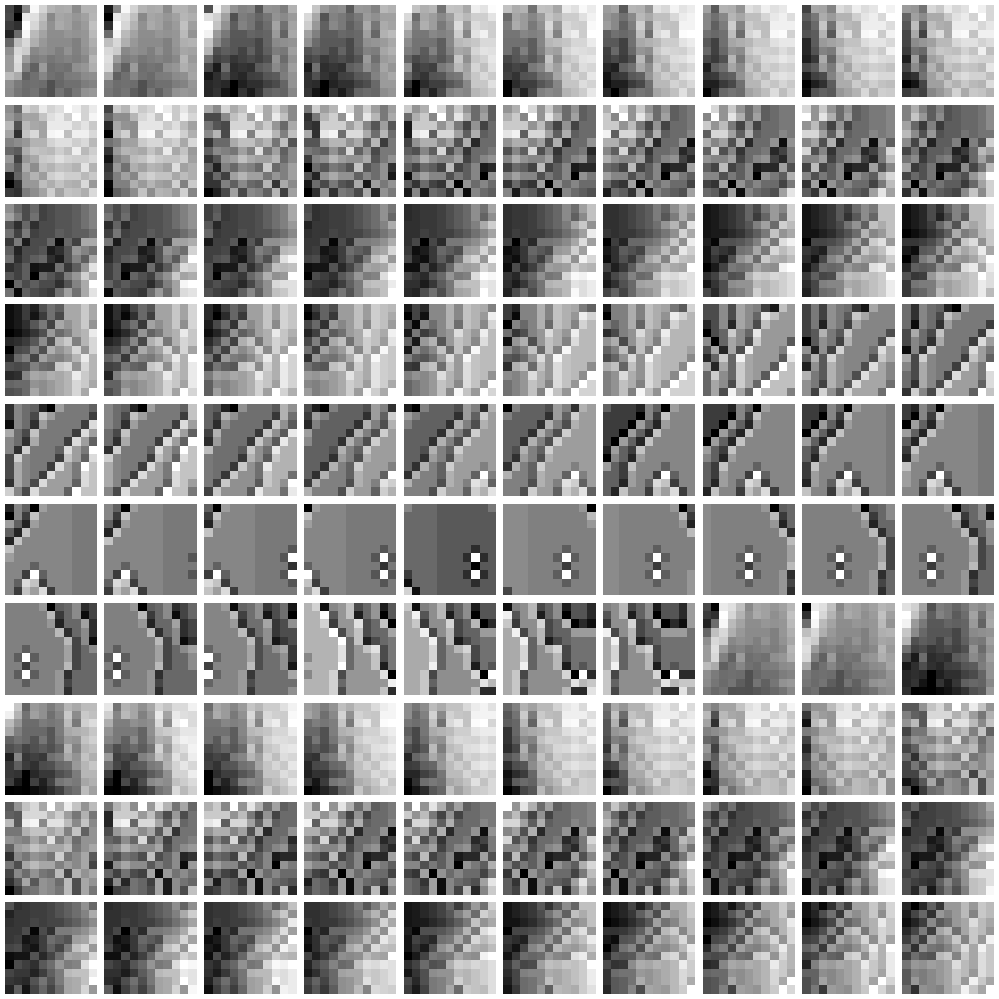

Total patches extracted: 31835
Total HOG vectors:  [[0.51522639 0.51522639 0.43808709 ... 0.05324254 0.18204525 0.03529067]
 [0.51122368 0.51122368 0.31628531 ... 0.10348434 0.23764901 0.04606983]
 [0.42711142 0.42711142 0.41233948 ... 0.13491198 0.29832942 0.3522336 ]
 ...
 [0.41837353 0.41837353 0.41837353 ... 0.29753453 0.26717237 0.27056883]
 [0.41971005 0.41971005 0.41971005 ... 0.22694836 0.23002419 0.38694545]
 [0.43851684 0.43851684 0.43851684 ... 0.14071669 0.20889619 0.40953363]]
Average HOG vectors:  [0.38016207 0.32561246 0.29558951 0.28195387 0.36947427 0.27784192
 0.29970316 0.32183796 0.29037484]
Global Average HOG Vector Length: 9
Global Average HOG Vector: [0.37398664 0.30788123 0.30060248 0.30053234 0.37652058 0.2977505
 0.30326097 0.30759359 0.27358197]
Average HOG vektör başarıyla 'C:/Users/Eren/Desktop/hog_vektor_kayit/average_hog_vector1.pkl' konumuna kaydedildi.


In [4]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
from skimage import measure
import math
import pickle
from joblib import Parallel, delayed
import os

def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

def ApplyErosion(label, kernel_size=3):
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    eroded_label = cv2.erode(label, kernel, iterations=4)
    return eroded_label

def GetImageLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    label = ConvertAndNormalize(label)
    label = ApplyErosion(label, kernel_size=3)
    return img, label

#Burda her bir label pikselinin = 1 olduğu konumlardan patchler alınıyor
def GetPatchesFromLabel(img, label, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, label.shape[0] - half_patch, step_size):
        for x in range(half_patch, label.shape[1] - half_patch, step_size):
            if label[y, x] > 0:
                patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
                patches.append(patch)
                positions.append((y, x))
    return patches, positions

def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)

def ComputeAverageHOG(hog_vectors):
    if len(hog_vectors) == 0:
        return None
    return np.mean(hog_vectors, axis=0)

def SaveAverageHOGVector(avg_hog_vector, file_path):
    output_dir = os.path.dirname(file_path)
    os.makedirs(output_dir, exist_ok=True)
    if os.path.exists(file_path):
        with open(file_path, 'rb') as file:
            existing_avg_vector = pickle.load(file)
        avg_hog_vector = (existing_avg_vector + avg_hog_vector) / 2
    with open(file_path, 'wb') as file:
        pickle.dump(avg_hog_vector, file)
    print(f"Average HOG vektör başarıyla '{file_path}' konumuna kaydedildi.")

def DisplayPatches(patches, max_cols=10, max_patches=100):
    num_patches = min(len(patches), max_patches)
    cols = min(max_cols, num_patches)
    rows = math.ceil(num_patches / cols)
    fig, axes = plt.subplots(rows, cols, figsize=(cols * 2, rows * 2))
    axes = np.array(axes).reshape(-1)
    for i, ax in enumerate(axes):
        if i < num_patches:
            ax.imshow(patches[i], cmap='gray')
            ax.axis('off')
        else:
            ax.axis('off')
    plt.tight_layout()
    plt.show()

def DisplayErosion(img, label):
    
    plt.figure(figsize=(10, 5))

    # Orijinal Görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.title("Image")
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 2, 2)
    plt.imshow(label, cmap='gray')
    plt.title("Erode Label")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

def DisplayImageAndLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    plt.figure(figsize=(10, 5))

    # Orijinal Görüntü
    plt.subplot(1, 2, 1)
    plt.imshow(img, cmap='gray')
    plt.title(imgStr)
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 2, 2)
    plt.imshow(label, cmap='gray')
    plt.title(labelStr)
    plt.axis("off")

    plt.tight_layout()
    plt.show()

if __name__ == "__main__":
    image_label_pairs = [
        (r"C:\Users\Eren\Desktop\processed_images\image(2).png", r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png"),
        (r"C:\Users\Eren\Desktop\processed_images\image(3).png", r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png"),
        (r"C:\Users\Eren\Desktop\processed_images\image(9).png", r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png")
    ]

    for img_path, label_path in image_label_pairs:
        # Görüntü ve labeli yan yana göster
        DisplayImageAndLabel(img_path, label_path)

    avg_output_path = "C:/Users/Eren/Desktop/hog_vektor_kayit/average_hog_vector1.pkl"

    all_average_hogs = []  # Tüm resimlerin ortalama HOG vektörlerini saklayacağımız liste

    for img_path, label_path in image_label_pairs:
        img, label = GetImageLabel(img_path, label_path)
        patches, positions = GetPatchesFromLabel(img, label, patch_size=11, step_size=1)
        hog_vectors = GenerateHOGVectors(patches)
        average_hog = ComputeAverageHOG(hog_vectors)

        if average_hog is not None:
            all_average_hogs.append(average_hog)  # Her resmin ortalamasını listeye ekle
        else:
            print("No HOG vectors to compute an average.")

        print(f"Processed {img_path} and {label_path}")
        DisplayErosion(img, label)
        DisplayPatches(patches, max_patches=100)

        print("Total patches extracted:", len(patches))
        print("Total HOG vectors: ", hog_vectors)
        print("Average HOG vectors: ", average_hog)
        

    # Tüm resimlerin genel ortalamasını hesapla
    if len(all_average_hogs) > 0:
        global_average_hog = np.mean(all_average_hogs, axis=0)
        print("Global Average HOG Vector Length:", len(global_average_hog))
        print("Global Average HOG Vector:", global_average_hog)
    else:
        print("No HOG vectors to compute a global average.")

    SaveAverageHOGVector(global_average_hog, avg_output_path)

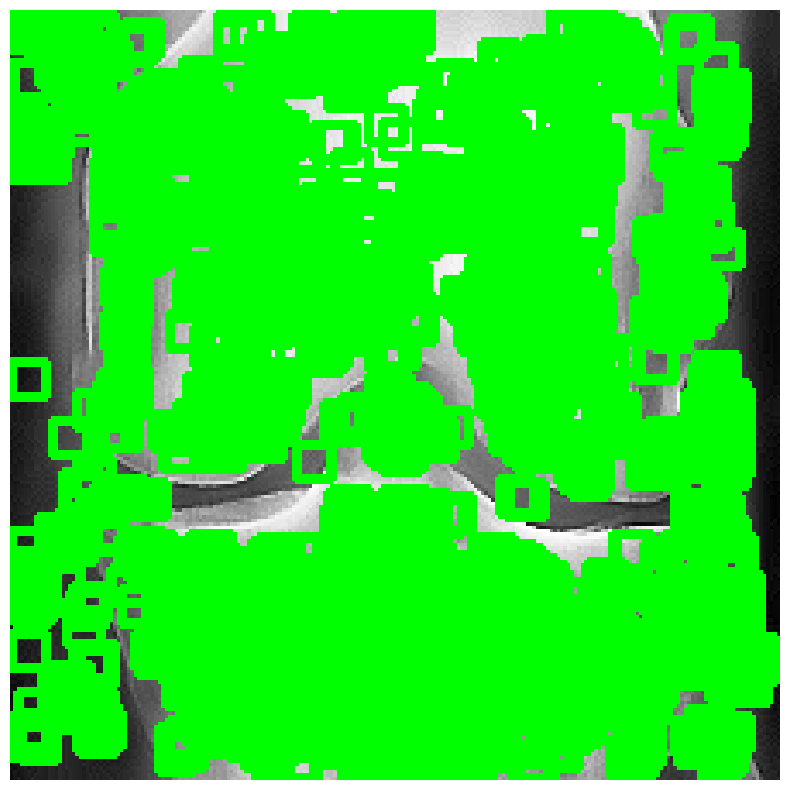

Total test patches extracted: 45796
Total matched patches: 4551


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
import pickle
from joblib import Parallel, delayed


def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)

# HOG vektör eşleşmelerini bulma
def MatchHOGVectors(average_hog_vector, test_hog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = []
    for i, test_vector in enumerate(test_hog_vectors):
        if similarity_metric == 'cosine':
            norm_avg = np.linalg.norm(average_hog_vector)
            norm_test = np.linalg.norm(test_vector)
            if norm_avg > 0 and norm_test > 0:
                similarity = np.dot(test_vector, average_hog_vector) / (norm_test * norm_avg)
            else:
                similarity = 0
            distance = 1 - similarity
        else:  # Default to Euclidean
            distance = np.linalg.norm(test_vector - average_hog_vector)

        if distance < threshold:
            matches.append(i)
    return matches

def DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11):
    half_patch = patch_size // 2
    output_img = cv2.cvtColor(test_img, cv2.COLOR_GRAY2BGR)
    for idx in matched_indices:
        y, x = test_positions[idx]
        cv2.rectangle(output_img, (x - half_patch, y - half_patch), (x + half_patch, y + half_patch), (0, 255, 0), 2)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def LoadAverageHOGVector(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş ortalama HOG vektörünü yükle
    avg_hog_vector_path = "C:/Users/Eren/Desktop/hog_vektor_kayit/average_hog_vector1.pkl"
    average_hog_vector = LoadAverageHOGVector(avg_hog_vector_path)

    # Test görüntüsü
    test_img_path = r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
    test_img = ConvertAndNormalize(test_img)

    # Test yamalarını oluştur (tüm görüntüde yamalar alınır)
    test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)

    # Test yamaları için HOG vektörleri oluştur
    test_hog_vectors = GenerateHOGVectors(test_patches)

    # Uyuşan yamaları bul
    matched_indices = MatchHOGVectors(average_hog_vector, test_hog_vectors, threshold=0.01,similarity_metric='cosine')

    # Uyuşan yamaları test görüntüsünde işaretle
    DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11)

    print("Total test patches extracted:", len(test_patches))
    print("Total matched patches:", len(matched_indices))


Processing: C:\Users\Eren\Desktop\processed_images\image(4).png


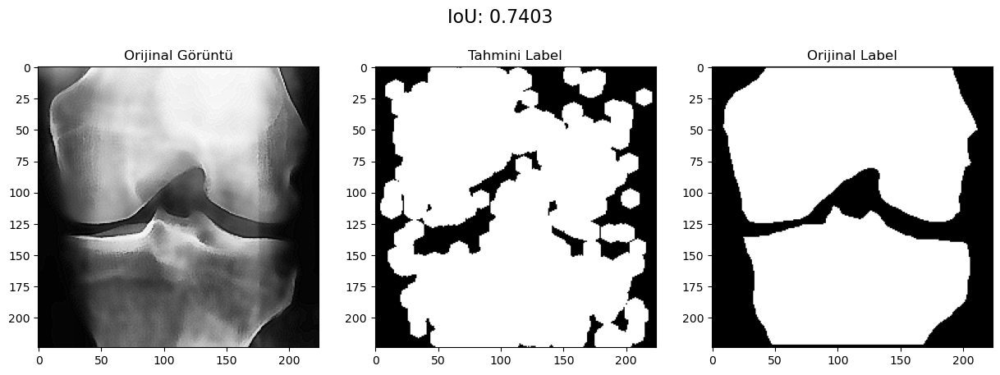

Processing: C:\Users\Eren\Desktop\processed_images\image(5).png


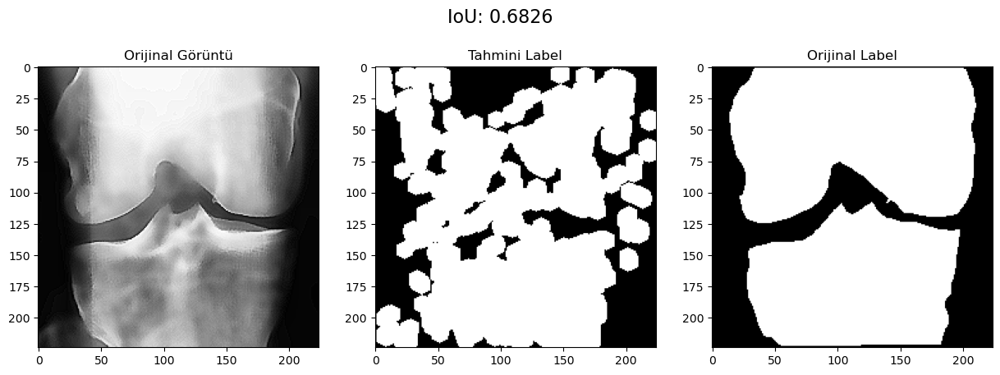

Processing: C:\Users\Eren\Desktop\processed_images\image(6).png


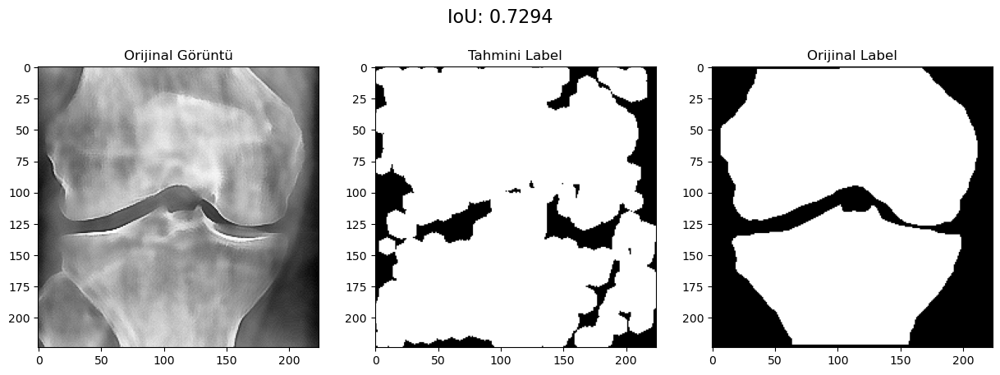

Processing: C:\Users\Eren\Desktop\processed_images\image(7).png


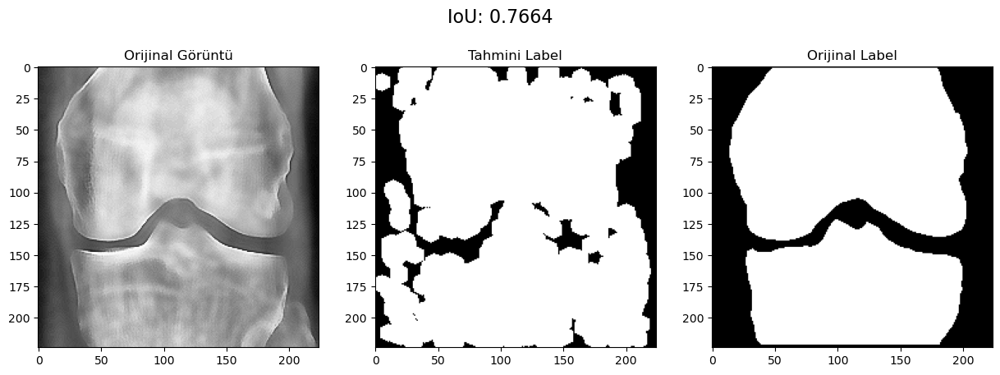

Processing: C:\Users\Eren\Desktop\processed_images\image(8).png


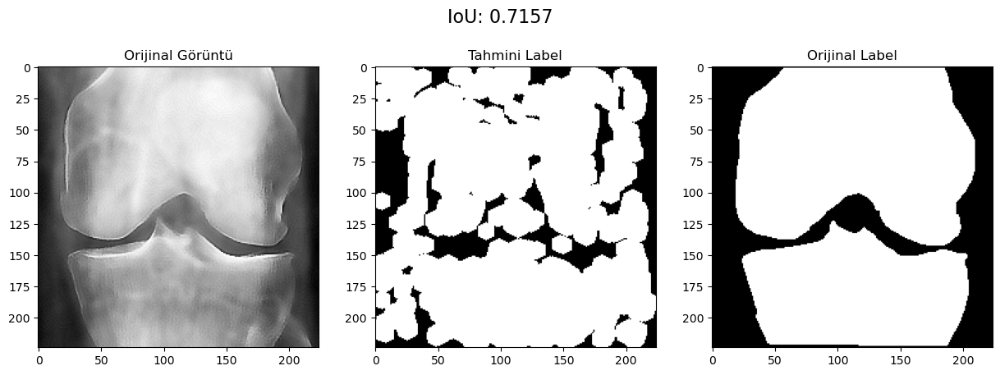

Ortalama IoU: 0.7269


In [5]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
from joblib import Parallel, delayed
import pickle

# Normalize ve gri tonlama işlemleri
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# Görüntüden yamalar çıkarma
def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

# HOG özellik vektörlerini çıkarma
def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features

# Paralel HOG hesaplaması
def GenerateHOGVectors(patches):
    hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in patches)
    return np.array(hog_vectors)

# HOG vektör eşleşmelerini bulma
def MatchHOGVectors(average_hog_vector, test_hog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = []
    for i, test_vector in enumerate(test_hog_vectors):
        if similarity_metric == 'cosine':
            norm_avg = np.linalg.norm(average_hog_vector)
            norm_test = np.linalg.norm(test_vector)
            if norm_avg > 0 and norm_test > 0:
                similarity = np.dot(test_vector, average_hog_vector) / (norm_test * norm_avg)
            else:
                similarity = 0
            distance = 1 - similarity
        else:  # Default to Euclidean
            distance = np.linalg.norm(test_vector - average_hog_vector)

        if distance < threshold:
            matches.append(i)
    return matches


# Delikleri doldurma
def fill_holes_with_contours(binary_mask):
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    filled_mask = np.zeros_like(binary_mask)
    for contour in contours:
        cv2.drawContours(filled_mask, [contour], -1, 255, thickness=cv2.FILLED)
    return filled_mask

# IoU hesaplama
def calculate_iou(mask1, mask2):
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    iou = intersection / union if union > 0 else 0
    return iou

# Özellik vektörlerini yükleme
def LoadFeatureVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ortalama IoU hesaplama
def calculate_average_iou(iou_values):
    if len(iou_values) == 0:
        return 0
    return sum(iou_values) / len(iou_values)
# Delikleri doldurma ve morfolojik işlemler uygulama
def refine_mask_with_morphology(binary_mask, kernel_size=5):
    # Yapılandırma elemanı (kernel) oluştur
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

    # Kapama işlemi (Closing: küçük boşlukları kapatır)
    closed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Açma işlemi (Opening: gürültüyü temizler)
    opened_mask = cv2.morphologyEx(closed_mask, cv2.MORPH_OPEN, kernel)

    # Dilasyon (Dilation: nesneleri genişletir)
    dilated_mask = cv2.dilate(opened_mask, kernel, iterations=1)

    return dilated_mask
# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    feature_vectors = LoadFeatureVectors("C:/Users/Eren/Desktop/hog_vektor_kayit/average_hog_vector1.pkl")

    # Test görüntüleri ve etiket yolları
    test_image_paths = [
        r"C:\Users\Eren\Desktop\processed_images\image(4).png",
        r"C:\Users\Eren\Desktop\processed_images\image(5).png",
        r"C:\Users\Eren\Desktop\processed_images\image(6).png",
        r"C:\Users\Eren\Desktop\processed_images\image(7).png",
        r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    ]

    label_paths = [
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(4).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(5).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(6).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(7).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(8).png'
    ]

    iou_values = []

    for test_img_path, label_path in zip(test_image_paths, label_paths):
        print(f"Processing: {test_img_path}")

        test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
        test_img = ConvertAndNormalize(test_img)

        # Yamaları oluştur ve özellik vektörlerini çıkar
        test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)
        test_hog_vectors = GenerateHOGVectors(test_patches)

        # Eşleşen yamaları bul
        matched_indices = MatchHOGVectors(feature_vectors, test_hog_vectors, threshold=0.01,similarity_metric='cosine')
        # İkili maske oluştur
        binary_mask = np.zeros(test_img.shape, dtype=np.uint8)
        for idx in matched_indices:
            y, x = test_positions[idx]
            cv2.circle(binary_mask, (x, y), 5, 255, -1)

        # Delikleri doldur ve morfolojik işlemler uygula
        filled_mask = fill_holes_with_contours(binary_mask)
        refined_mask = refine_mask_with_morphology(filled_mask)

        reference_label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

        if reference_label is None:
            raise FileNotFoundError(f"Referans label bulunamadı: {label_path}")

        # IoU hesapla
        iou = calculate_iou(refined_mask > 0, reference_label > 0)
        iou_values.append(iou)

        # Görselleştirme
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.title("Orijinal Görüntü")
        plt.imshow(test_img, cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title("Tahmini Label")
        plt.imshow(refined_mask, cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title("Orijinal Label")
        plt.imshow(reference_label, cmap='gray')

        plt.suptitle(f"IoU: {iou:.4f}", fontsize=16)
        plt.show()

    # Ortalama IoU hesapla ve yazdır
    average_iou = calculate_average_iou(iou_values)
    print(f"Ortalama IoU: {average_iou:.4f}")


**(3.MADDE) img yerine LBP(img) koyulacak. Organ bölgesinin LBP'si Hog veya CoHog ile kodlanacak.**  
Burda labeliyle noktasal çarpılmış organ görüntüsüne LBP uygulandıktan sonra CoHog ile kodlanıp GLCM matrisleri oluşturuldu GLCM matrisinde yatay ve dikey yönler olmak üzere iki yönde özellikler çıkarıldı ve vektöre dönüştürüldü. Daha sonra test görselleriyle IoU skoru hesaplandı.

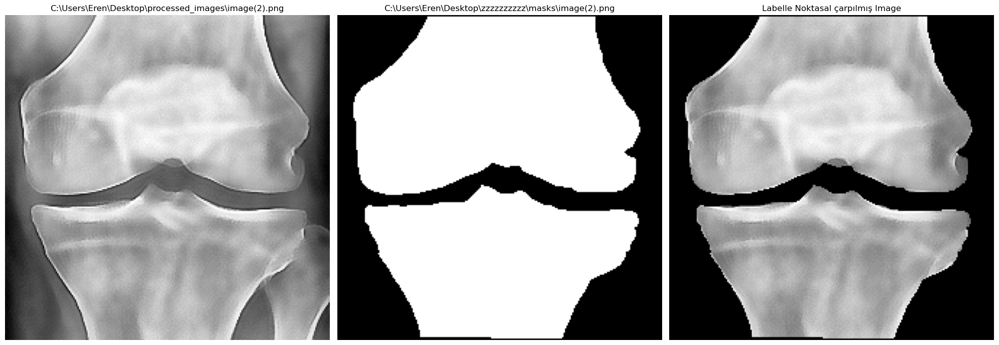

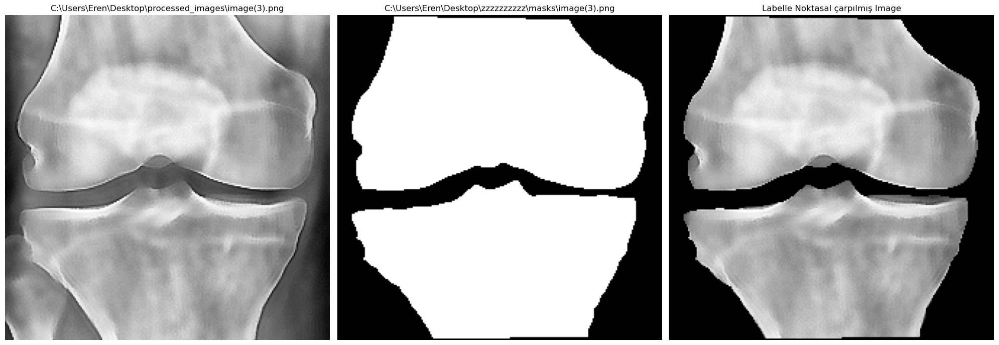

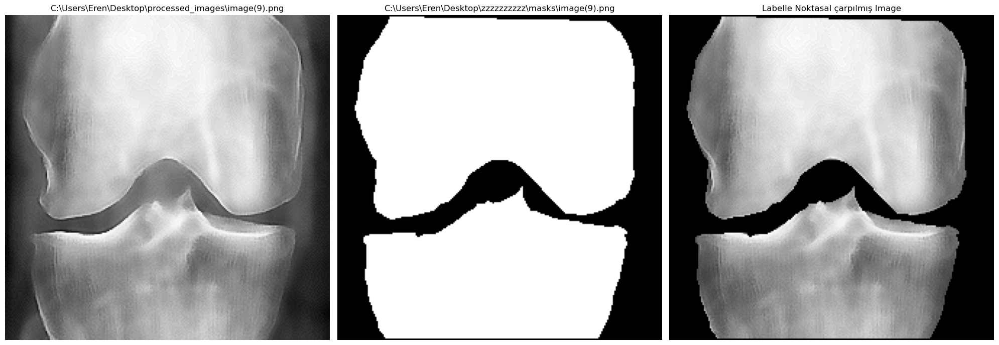

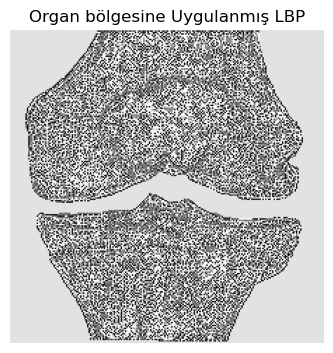

CoHoG Vectors: [14154.376601537479, 14119.18181454196, 0.019380716212983057, 0.02181902118311018, 0.3475035289285648, 0.34431126065376344, 0.3922506263681057, 0.38795408550726723]


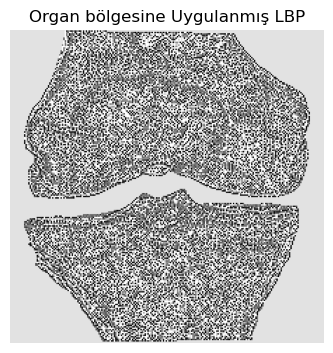

CoHoG Vectors: [15108.964125560538, 15001.727978859715, -0.011991475817203492, -0.004808847977275335, 0.30752902939402693, 0.3053207761983764, 0.34970110750863115, 0.348348221425714]


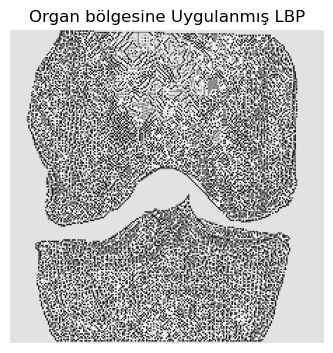

CoHoG Vectors: [15493.762732222935, 15042.038276745674, -0.025513579739367968, 0.004385520395221203, 0.29617903679584134, 0.2953901383364568, 0.3346502451253212, 0.3380765735644212]
COHOG vektör başarıyla 'C:/Users/Eren/Desktop/cohog_vektor_kayit/LBP_all_cohog_vectors.pkl' konumuna kaydedildi.
Total CoHoG Vectors Shape: 3
Total CoHoG Vectors: [[14154.376601537479, 14119.18181454196, 0.019380716212983057, 0.02181902118311018, 0.3475035289285648, 0.34431126065376344, 0.3922506263681057, 0.38795408550726723], [15108.964125560538, 15001.727978859715, -0.011991475817203492, -0.004808847977275335, 0.30752902939402693, 0.3053207761983764, 0.34970110750863115, 0.348348221425714], [15493.762732222935, 15042.038276745674, -0.025513579739367968, 0.004385520395221203, 0.29617903679584134, 0.2953901383364568, 0.3346502451253212, 0.3380765735644212]]


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import  local_binary_pattern
from skimage.feature import graycomatrix, graycoprops
import pickle
import os

# Görüntü normalizasyon fonksiyonu
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# LBP uygulama fonksiyonu
def ApplyLBP(img, radius=1, n_points=8):
    lbp = local_binary_pattern(img, n_points, radius, method="uniform")
    lbp_normalized = (lbp / lbp.max() * 255).astype(np.uint8)
    # Maske ile dış alanları sıfırla
    return lbp_normalized 
 
#Image için özellik vektörü oluşturma
def compute_glcm_vector(lbp_image):
    lbp_image_uint8 = (lbp_image * (255 / lbp_image.max())).astype(np.uint8)
    glcm = graycomatrix(lbp_image_uint8, distances=[1], angles=[0, np.pi / 2], symmetric=True, normed=True)
    
    contrast = graycoprops(glcm, 'contrast')
    correlation = graycoprops(glcm, 'correlation')
    energy = graycoprops(glcm, 'energy')
    homogeneity = graycoprops(glcm, 'homogeneity')
    
    # Tüm değerleri float'a dönüştür
    feature_vector = [
        float(contrast[0, 0]), 
        float(contrast[0, 1]),
        float(correlation[0, 0]), 
        float(correlation[0, 1]),
        float(energy[0, 0]), 
        float(energy[0, 1]),
        float(homogeneity[0, 0]), 
        float(homogeneity[0, 1]),
    ]
    
    return feature_vector


# COHOG vektörlerini bir dosyaya kaydetme
def SaveCOHOGVectors(cohog_vectors, file_path):
    output_dir = os.path.dirname(file_path)
    os.makedirs(output_dir, exist_ok=True)  # Klasör yoksa oluştur
    with open(file_path, 'wb') as file:
        pickle.dump(cohog_vectors, file)
    print(f"COHOG vektör başarıyla '{file_path}' konumuna kaydedildi.")
    
#Noktasal çarpma işlemi burada yapılıyor hedef organ tek bırakılıyor
def GetImageLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    label = ConvertAndNormalize(label)

    # Label'i ikili (binary) maske haline getirme
    _, binary_label = cv2.threshold(label, 127, 1, cv2.THRESH_BINARY)

    # Noktasal çarpma işlemi
    masked_image = img * binary_label
    return masked_image ,img ,label

def DisplayImageAndLabel(imgStr, labelStr, maskimage):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    plt.figure(figsize=(20, 10))

    # Orijinal Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(img, cmap='gray')
    plt.title(imgStr)
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 3, 2)
    plt.imshow(label, cmap='gray')
    plt.title(labelStr)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(maskimage, cmap='gray')
    plt.title("Labelle Noktasal çarpılmış Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

def DisplayApplyLBP(maskimage):
    
    plt.figure(figsize=(10, 5))

    # LBP uygulanmış Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(maskimage, cmap='gray')
    plt.title("Organ bölgesine Uygulanmış LBP")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


# Ana akış
if __name__ == "__main__":
    # Çoklu görüntü ve etiket dosya yolları
    image_paths = [r"C:\Users\Eren\Desktop\processed_images\image(2).png", 
                   r"C:\Users\Eren\Desktop\processed_images\image(3).png",
                   r"C:\Users\Eren\Desktop\processed_images\image(9).png"]
    
    label_paths = [r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png", 
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png",
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png" ]

    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)
        DisplayImageAndLabel(img_path, label_path, maskedimg)

    all_cohog_vectors = []
        
    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)

        lbp_image = ApplyLBP(maskedimg)

        DisplayApplyLBP(lbp_image)
        #Her gorselde organ bolgesinden cohog vektoru uret
        cohog_vectors = compute_glcm_vector(lbp_image)
        all_cohog_vectors.append(cohog_vectors)

        print("CoHoG Vectors:", cohog_vectors)
        
    
    # Tüm HOG vektörlerini bir dosyaya kaydet
    SaveCOHOGVectors(all_cohog_vectors, "C:/Users/Eren/Desktop/cohog_vektor_kayit/LBP_all_cohog_vectors.pkl")

    print("Total CoHoG Vectors Shape:", len(all_cohog_vectors))
    print("Total CoHoG Vectors:", all_cohog_vectors)


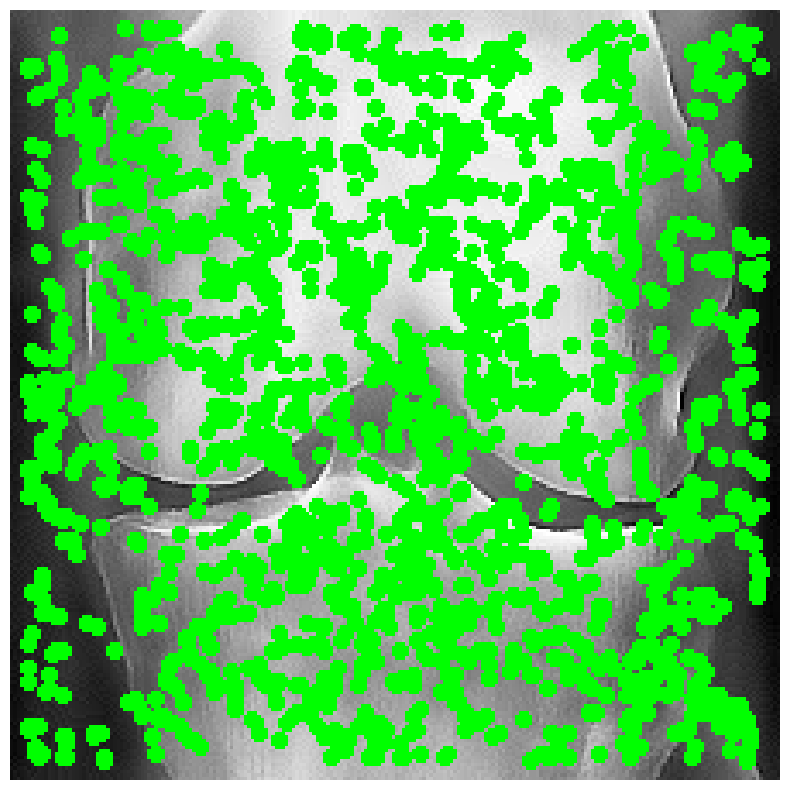

Total test patches extracted: 45796
Total matched patches: 1952


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pickle
from joblib import Parallel, delayed
from skimage.feature import local_binary_pattern
from skimage.feature.texture import graycomatrix, graycoprops

def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# LBP uygulama fonksiyonu
def ApplyLBP(img, radius=1, n_points=8):
    lbp = local_binary_pattern(img, n_points, radius, method="uniform")
    lbp_normalized = (lbp / lbp.max() * 255).astype(np.uint8)
    return lbp_normalized

def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

def compute_glcm_vector(lbp_image):
    lbp_image_uint8 = (lbp_image * (255 / lbp_image.max())).astype(np.uint8)
    glcm = graycomatrix(lbp_image_uint8, distances=[1], angles=[0, np.pi / 2], symmetric=True, normed=True)
    
    contrast = graycoprops(glcm, 'contrast')
    correlation = graycoprops(glcm, 'correlation')
    energy = graycoprops(glcm, 'energy')
    homogeneity = graycoprops(glcm, 'homogeneity')
    
    feature_vector = [
        float(contrast[0, 0]), float(contrast[0, 1]),
        float(correlation[0, 0]), float(correlation[0, 1]),
        float(energy[0, 0]), float(energy[0, 1]),
        float(homogeneity[0, 0]), float(homogeneity[0, 1]),
    ]
    
    return feature_vector


def MatchCOHOGVectors(cohog_vectors, test_cohog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = set(range(len(test_cohog_vectors)))  # Başlangıçta tüm test vektörlerini eşleşme adayı olarak kabul et
    for cohog_vector in cohog_vectors:
        current_matches = set()
        cohog_vector = np.array(cohog_vector)  # NumPy dizisine dönüştür
        for i, test_vector in enumerate(test_cohog_vectors):
            test_vector = np.array(test_vector)  # NumPy dizisine dönüştür
            if similarity_metric == 'cosine':
                norm_avg = np.linalg.norm(cohog_vector)
                norm_test = np.linalg.norm(test_vector)
                if norm_avg > 0 and norm_test > 0:
                    similarity = np.dot(test_vector, cohog_vector) / (norm_test * norm_avg)
                else:
                    similarity = 0
                distance = 1 - similarity
            elif similarity_metric == 'euclidean':
                distance = np.linalg.norm(test_vector - cohog_vector)
            else:
                raise ValueError(f"Unsupported similarity metric: {similarity_metric}")

            if distance < threshold:
                current_matches.add(i)
        matches &= current_matches  # Ortak eşleşmeleri bul
    return list(matches)

def DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11):
    half_patch = patch_size // 2
    output_img = cv2.cvtColor(test_img, cv2.COLOR_GRAY2BGR)
    for idx in matched_indices:
        y, x = test_positions[idx]
        cv2.rectangle(output_img, (x - half_patch, y - half_patch), (x + half_patch, y + half_patch), (0, 255, 0), 2)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def LoadAverageCOHOGVector(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ana akış
if __name__ == "__main__":
    cohog_vector_path = "C:/Users/Eren/Desktop/cohog_vektor_kayit/LBP_all_cohog_vectors.pkl"
    cohog_vector = LoadAverageCOHOGVector(cohog_vector_path)

    test_img_path = r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
    test_img = ConvertAndNormalize(test_img)
    LBPimg = ApplyLBP(test_img)

    test_patches, test_positions = GetPatchesFromImage(LBPimg, patch_size=11, step_size=1)

    # Paralel GLCM hesaplamaları
    test_cohog_vectors = Parallel(n_jobs=-1)(delayed(compute_glcm_vector)(patch) for patch in test_patches)

    matched_indices = MatchCOHOGVectors(cohog_vector, test_cohog_vectors, threshold=0.00005, similarity_metric='cosine')

    DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=2)

    print("Total test patches extracted:", len(test_patches))
    print("Total matched patches:", len(matched_indices))

Processing: C:\Users\Eren\Desktop\processed_images\image(4).png


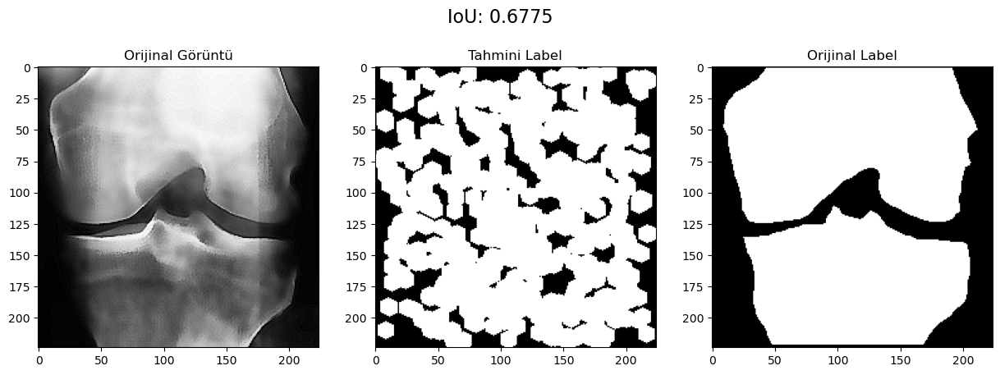

Processing: C:\Users\Eren\Desktop\processed_images\image(5).png


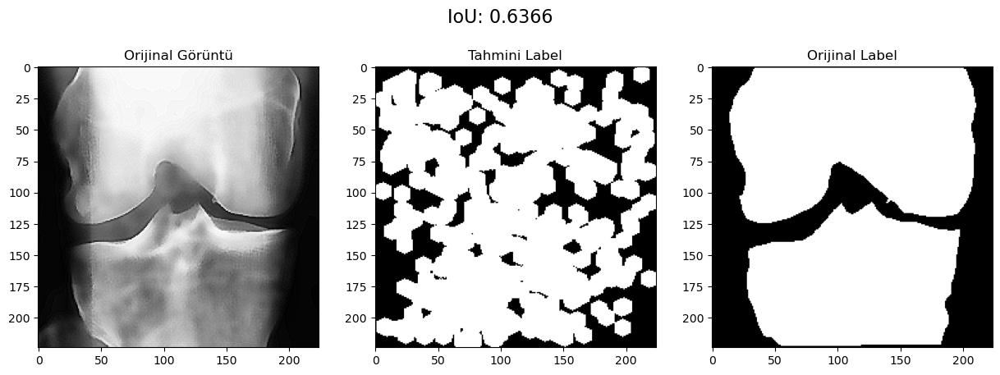

Processing: C:\Users\Eren\Desktop\processed_images\image(6).png


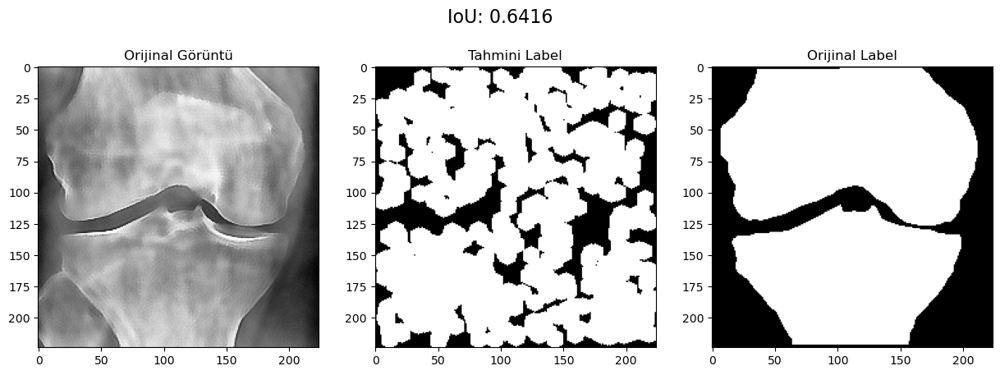

Processing: C:\Users\Eren\Desktop\processed_images\image(7).png


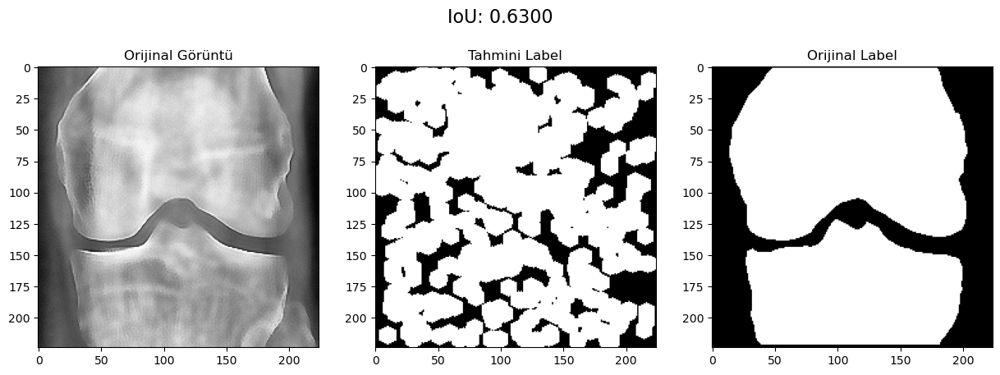

Processing: C:\Users\Eren\Desktop\processed_images\image(8).png


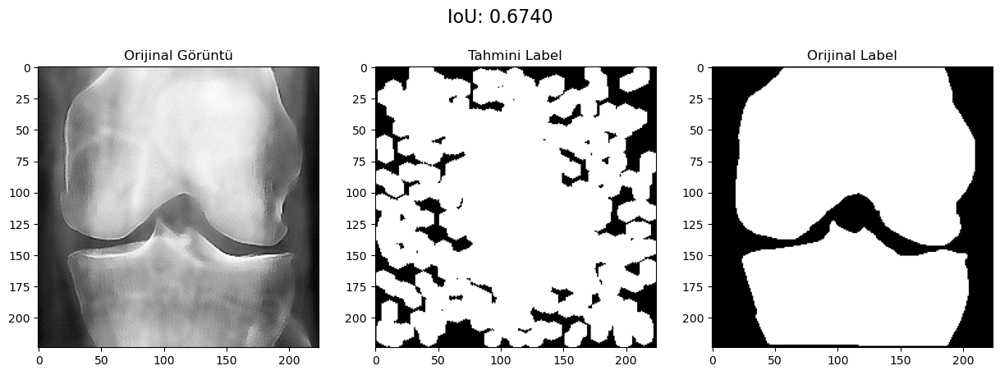

Ortalama IoU: 0.6519


In [4]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
from joblib import Parallel, delayed
import pickle
from skimage.feature import local_binary_pattern
from skimage.feature.texture import graycomatrix, graycoprops



# LBP uygulama fonksiyonu
def ApplyLBP(img, radius=1, n_points=8):
    lbp = local_binary_pattern(img, n_points, radius, method="uniform")
    lbp_normalized = (lbp / lbp.max() * 255).astype(np.uint8)
    return lbp_normalized

# Normalize ve gri tonlama işlemleri
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# Görüntüden yamalar çıkarma
def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

# COHOG özellik vektörlerini çıkarma
def compute_glcm_vector(lbp_image):
    lbp_image_uint8 = (lbp_image * (255 / lbp_image.max())).astype(np.uint8)
    glcm = graycomatrix(lbp_image_uint8, distances=[1], angles=[0, np.pi / 2], symmetric=True, normed=True)
    
    contrast = graycoprops(glcm, 'contrast')
    correlation = graycoprops(glcm, 'correlation')
    energy = graycoprops(glcm, 'energy')
    homogeneity = graycoprops(glcm, 'homogeneity')
    
    feature_vector = [
        float(contrast[0, 0]), 
        float(contrast[0, 1]),
        float(correlation[0, 0]), 
        float(correlation[0, 1]),
        float(energy[0, 0]), 
        float(energy[0, 1]),
        float(homogeneity[0, 0]), 
        float(homogeneity[0, 1]),
    ]
    
    return feature_vector


# COHOG vektör eşleşmelerini bulma
def MatchCOHOGVectors(cohog_vectors, test_cohog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = set(range(len(test_cohog_vectors)))  # Başlangıçta tüm test vektörlerini eşleşme adayı olarak kabul et
    for cohog_vector in cohog_vectors:
        current_matches = set()
        cohog_vector = np.array(cohog_vector)  # NumPy dizisine dönüştür
        for i, test_vector in enumerate(test_cohog_vectors):
            test_vector = np.array(test_vector)  # NumPy dizisine dönüştür
            if similarity_metric == 'cosine':
                norm_avg = np.linalg.norm(cohog_vector)
                norm_test = np.linalg.norm(test_vector)
                if norm_avg > 0 and norm_test > 0:
                    similarity = np.dot(test_vector, cohog_vector) / (norm_test * norm_avg)
                else:
                    similarity = 0
                distance = 1 - similarity
            elif similarity_metric == 'euclidean':
                distance = np.linalg.norm(test_vector - cohog_vector)
            else:
                raise ValueError(f"Unsupported similarity metric: {similarity_metric}")

            if distance < threshold:
                current_matches.add(i)
        matches &= current_matches  # Ortak eşleşmeleri bul
    return list(matches)


# Delikleri doldurma
def fill_holes_with_contours(binary_mask):
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    filled_mask = np.zeros_like(binary_mask)
    for contour in contours:
        cv2.drawContours(filled_mask, [contour], -1, 255, thickness=cv2.FILLED)
    return filled_mask

# IoU hesaplama
def calculate_iou(mask1, mask2):
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    iou = intersection / union if union > 0 else 0
    return iou

# Özellik vektörlerini yükleme
def LoadFeatureVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ortalama IoU hesaplama
def calculate_average_iou(iou_values):
    if len(iou_values) == 0:
        return 0
    return sum(iou_values) / len(iou_values)
# Delikleri doldurma ve morfolojik işlemler uygulama
def refine_mask_with_morphology(binary_mask, kernel_size=5):
    # Yapılandırma elemanı (kernel) oluştur
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

    # Kapama işlemi (Closing: küçük boşlukları kapatır)
    closed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Açma işlemi (Opening: gürültüyü temizler)
    opened_mask = cv2.morphologyEx(closed_mask, cv2.MORPH_OPEN, kernel)

    # Dilasyon (Dilation: nesneleri genişletir)
    dilated_mask = cv2.dilate(opened_mask, kernel, iterations=1)

    return dilated_mask
# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    feature_vectors = LoadFeatureVectors("C:/Users/Eren/Desktop/cohog_vektor_kayit/LBP_all_cohog_vectors.pkl")

    # Test görüntüleri ve etiket yolları
    test_image_paths = [
        r"C:\Users\Eren\Desktop\processed_images\image(4).png",
        r"C:\Users\Eren\Desktop\processed_images\image(5).png",
        r"C:\Users\Eren\Desktop\processed_images\image(6).png",
        r"C:\Users\Eren\Desktop\processed_images\image(7).png",
        r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    ]

    label_paths = [
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(4).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(5).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(6).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(7).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(8).png'
    ]

    iou_values = []

    for test_img_path, label_path in zip(test_image_paths, label_paths):
        print(f"Processing: {test_img_path}")

        test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
        test_img = ConvertAndNormalize(test_img)

        LBPimage = ApplyLBP(test_img)

        # Yamaları oluştur ve özellik vektörlerini çıkar
        test_patches, test_positions = GetPatchesFromImage(LBPimage, patch_size=11, step_size=1)
        test_cohog_vectors = Parallel(n_jobs=-1)(delayed(compute_glcm_vector)(patch) for patch in test_patches)

        # Eşleşen yamaları bul
        matched_indices = MatchCOHOGVectors(feature_vectors, test_cohog_vectors, threshold=0.00003,similarity_metric='cosine')
        # İkili maske oluştur
        binary_mask = np.zeros(test_img.shape, dtype=np.uint8)
        for idx in matched_indices:
            y, x = test_positions[idx]
            cv2.circle(binary_mask, (x, y), 5, 255, -1)

        # Delikleri doldur ve morfolojik işlemler uygula
        filled_mask = fill_holes_with_contours(binary_mask)
        refined_mask = refine_mask_with_morphology(filled_mask)

        reference_label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

        if reference_label is None:
            raise FileNotFoundError(f"Referans label bulunamadı: {label_path}")

        # IoU hesapla
        iou = calculate_iou(refined_mask > 0, reference_label > 0)
        iou_values.append(iou)

        # Görselleştirme
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.title("Orijinal Görüntü")
        plt.imshow(test_img, cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title("Tahmini Label")
        plt.imshow(refined_mask, cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title("Orijinal Label")
        plt.imshow(reference_label, cmap='gray')

        plt.suptitle(f"IoU: {iou:.4f}", fontsize=16)
        plt.show()

    # Ortalama IoU hesapla ve yazdır
    average_iou = calculate_average_iou(iou_values)
    print(f"Ortalama IoU: {average_iou:.4f}")

**LBP(img) HOG ile kodlandı ve karşılaştırma yapıldı.**

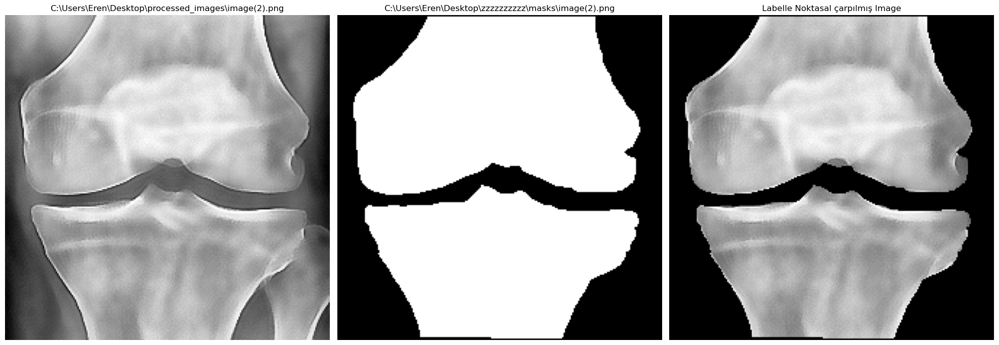

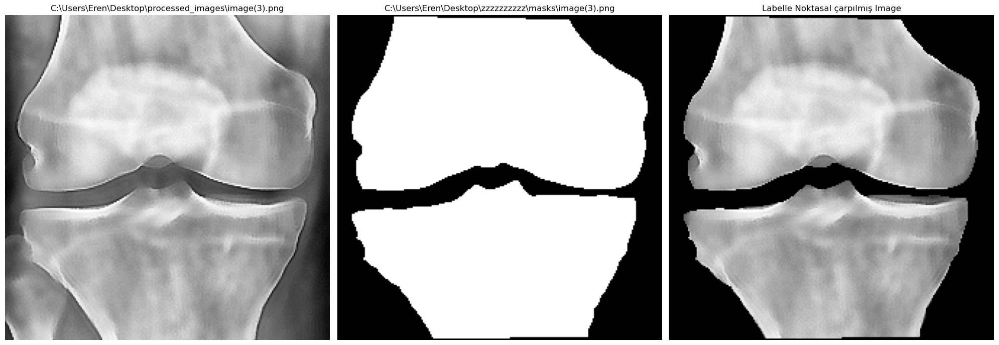

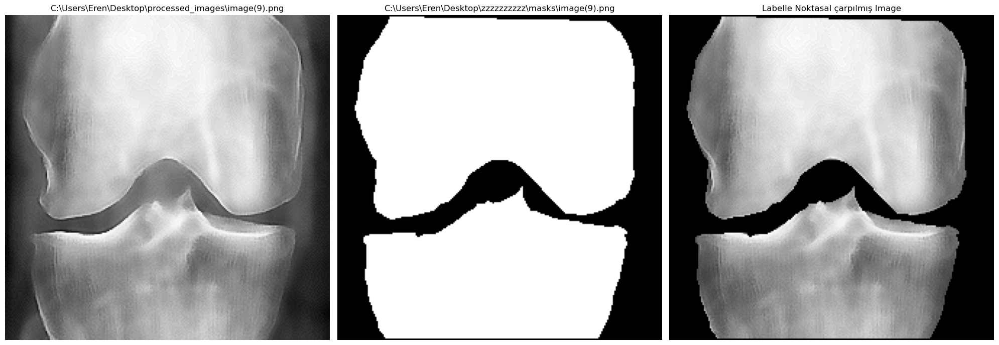

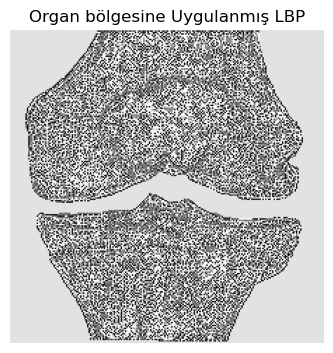

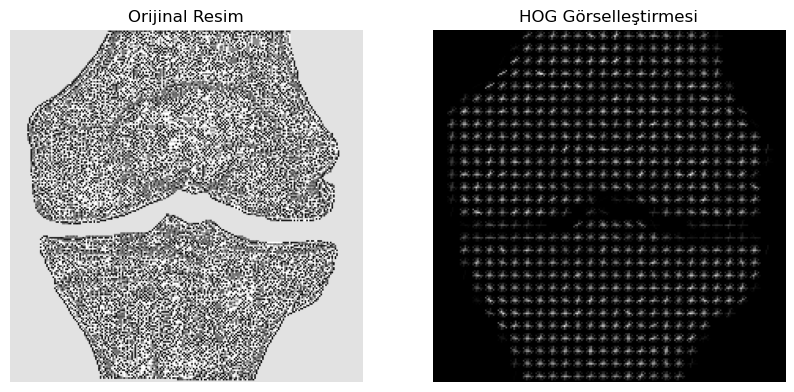

HoG Vectors: [0.21162257077077226, 0.3214288564436466, 0.17225555950776578, 0.2587761673710349, 0.2912210372425208, 0.23046741500877535, 0.1627295826277785, 0.32269898644862405, 0.09832439862231908]


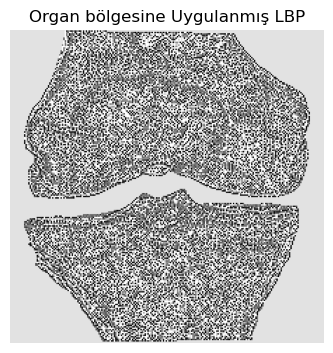

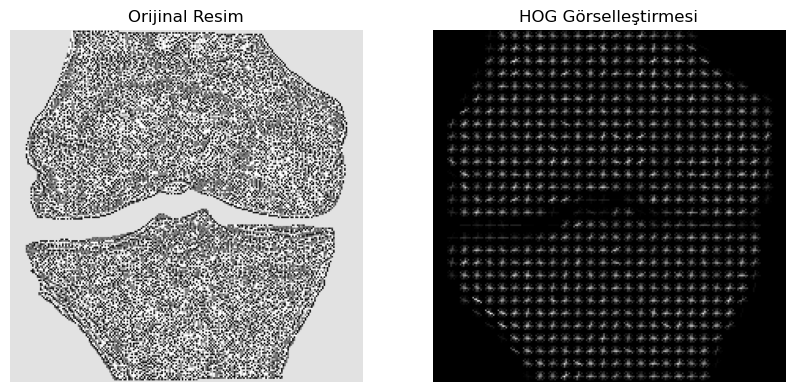

HoG Vectors: [0.23568429890519846, 0.32117217784344565, 0.18978430751398237, 0.26422816238451535, 0.3104586298692471, 0.25203126016774974, 0.16968442132025988, 0.32216195707654693, 0.1448326707136782]


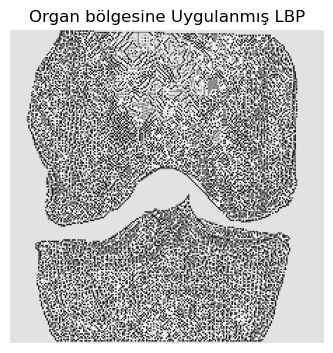

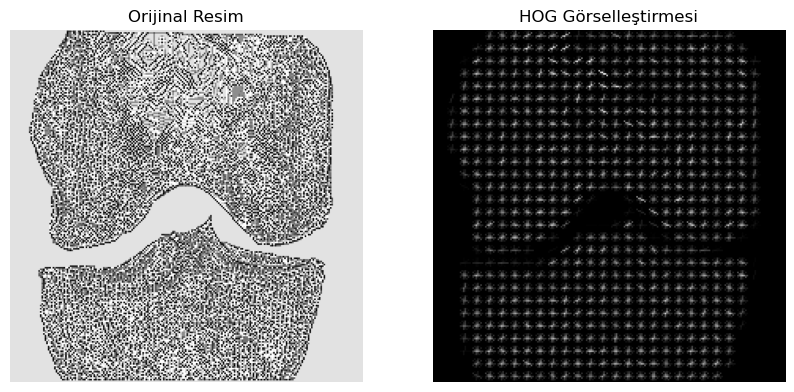

HoG Vectors: [0.2582664186121997, 0.3100398852846091, 0.2241835451385559, 0.2273255702367021, 0.283612376161103, 0.2147164477914002, 0.24441952955064702, 0.32309277975096024, 0.17438220307525157]
HOG vektör başarıyla 'C:/Users/Eren/Desktop/hog_vektor_kayit/LBP_new_all_hog_vectors.pkl' konumuna kaydedildi.
Total HoG Vectors Shape: 3
Total HoG Vectors: [[0.21162257077077226, 0.3214288564436466, 0.17225555950776578, 0.2587761673710349, 0.2912210372425208, 0.23046741500877535, 0.1627295826277785, 0.32269898644862405, 0.09832439862231908], [0.23568429890519846, 0.32117217784344565, 0.18978430751398237, 0.26422816238451535, 0.3104586298692471, 0.25203126016774974, 0.16968442132025988, 0.32216195707654693, 0.1448326707136782], [0.2582664186121997, 0.3100398852846091, 0.2241835451385559, 0.2273255702367021, 0.283612376161103, 0.2147164477914002, 0.24441952955064702, 0.32309277975096024, 0.17438220307525157]]


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import  local_binary_pattern
import pickle
import os
from skimage.feature import hog

# Görüntü normalizasyon fonksiyonu
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# LBP uygulama fonksiyonu
def ApplyLBP(img, radius=1, n_points=8):
    lbp = local_binary_pattern(img, n_points, radius, method="uniform")
    lbp_normalized = (lbp / lbp.max() * 255).astype(np.uint8)
    # Maske ile dış alanları sıfırla
    return lbp_normalized 
 
def extract_hog_features_combined(image, cells_per_region=(10, 10)):
    """
    Görüntü için HOG özelliklerini çıkarır ve yerel HOG vektörlerini birleştirir.

    Parameters:
        image (ndarray): Gri ölçekli görüntü.
        cells_per_region (tuple): Birleştirme için kaç hücrelik bölgelerin ele alınacağı (satır, sütun).

    Returns:
        combined_hog_features (ndarray): Birleştirilmiş HOG özellik vektörü.
    """
    # HOG özelliklerini çıkar
    hog_features, hog_image = hog(
        image,
        orientations=9,
        pixels_per_cell=(8, 8),
        cells_per_block=(1, 1),
        block_norm='L2-Hys',
        visualize=True,
        transform_sqrt=True,
        feature_vector=False  # Özellikler lokal olarak alınsın
    )

    # Hücreleri gruplayarak özellikleri birleştirme
    cell_rows, cell_cols = hog_features.shape[:2]
    region_rows, region_cols = cells_per_region

    combined_hog_features = []

    # Yerel özellikleri belirli bölgelerden birleştir
    for i in range(0, cell_rows, region_rows):
        for j in range(0, cell_cols, region_cols):
            # Bölge içindeki HOG özelliklerini alın
            region_features = hog_features[
                i:i + region_rows,
                j:j + region_cols
            ].ravel()

            # Bölge özelliklerini birleştir (ortalama alınabilir)
            combined_hog_features.append(np.mean(region_features))

    #combined_hog_features = np.array(combined_hog_features).ravel()

    # Sonuçları görselleştir
    plt.figure(figsize=(10, 5))

    # Orijinal resim
    plt.subplot(1, 2, 1)
    plt.title("Orijinal Resim")
    plt.imshow(image, cmap='gray')
    plt.axis("off")

    # HOG görselleştirmesi
    plt.subplot(1, 2, 2)
    plt.title("HOG Görselleştirmesi")
    plt.imshow(hog_image, cmap='gray')
    plt.axis("off")

    plt.show()

    return combined_hog_features


# HOG vektörlerini bir dosyaya kaydetme
def SaveHOGVectors(hog_vectors, file_path):
    output_dir = os.path.dirname(file_path)
    os.makedirs(output_dir, exist_ok=True)  # Klasör yoksa oluştur
    with open(file_path, 'wb') as file:
        pickle.dump(hog_vectors, file)
    print(f"HOG vektör başarıyla '{file_path}' konumuna kaydedildi.")
    
#Noktasal çarpma işlemi burada yapılıyor hedef organ tek bırakılıyor
def GetImageLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    label = ConvertAndNormalize(label)

    # Label'i ikili (binary) maske haline getirme
    _, binary_label = cv2.threshold(label, 127, 1, cv2.THRESH_BINARY)

    # Noktasal çarpma işlemi
    masked_image = img * binary_label
    return masked_image ,img ,label

def DisplayImageAndLabel(imgStr, labelStr, maskimage):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    plt.figure(figsize=(20, 10))

    # Orijinal Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(img, cmap='gray')
    plt.title(imgStr)
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 3, 2)
    plt.imshow(label, cmap='gray')
    plt.title(labelStr)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(maskimage, cmap='gray')
    plt.title("Labelle Noktasal çarpılmış Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()

def DisplayApplyLBP(maskimage):
    
    plt.figure(figsize=(10, 5))

    # LBP uygulanmış Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(maskimage, cmap='gray')
    plt.title("Organ bölgesine Uygulanmış LBP")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


# Ana akış
if __name__ == "__main__":
    # Çoklu görüntü ve etiket dosya yolları
    image_paths = [r"C:\Users\Eren\Desktop\processed_images\image(2).png", 
                   r"C:\Users\Eren\Desktop\processed_images\image(3).png",
                   r"C:\Users\Eren\Desktop\processed_images\image(9).png"]
    
    label_paths = [r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png", 
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png",
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png" ]

    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)
        DisplayImageAndLabel(img_path, label_path, maskedimg)

    all_hog_vectors = []
        
    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)

        lbp_image = ApplyLBP(maskedimg)

        DisplayApplyLBP(lbp_image)
        #Her gorselde organ bolgesinden hog vektoru uret
        hog_vectors = extract_hog_features_combined(lbp_image)
        all_hog_vectors.append(hog_vectors)

        print("HoG Vectors:", hog_vectors)
        
    
    # Tüm HOG vektörlerini bir dosyaya kaydet
    SaveHOGVectors(all_hog_vectors, "C:/Users/Eren/Desktop/hog_vektor_kayit/LBP_new_all_hog_vectors.pkl")

    print("Total HoG Vectors Shape:", len(all_hog_vectors))
    print("Total HoG Vectors:", all_hog_vectors)

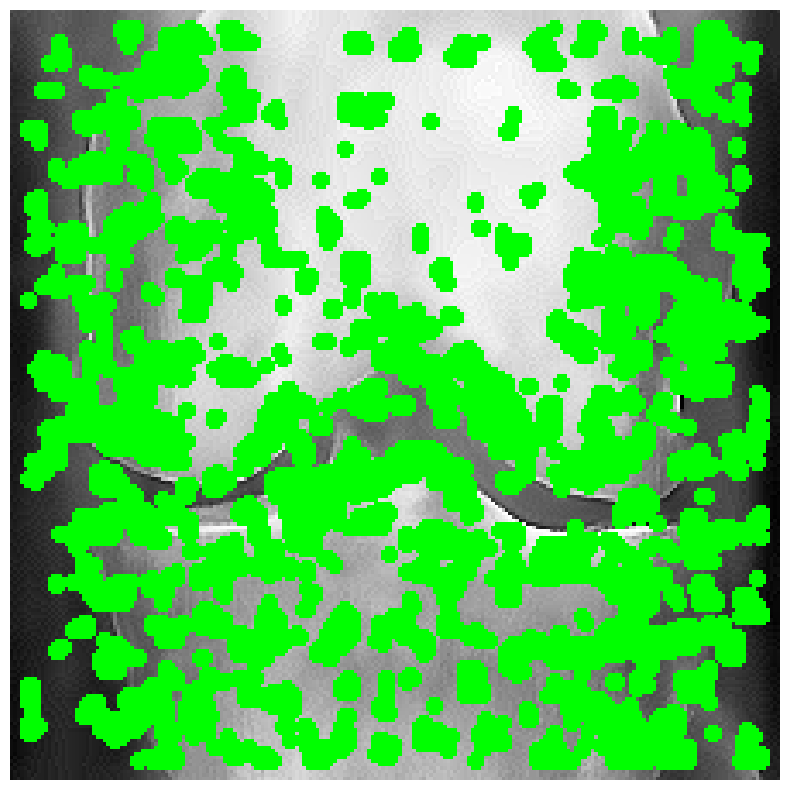

Total test patches extracted: 45796
Total matched patches: 6484


In [2]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pickle
from joblib import Parallel, delayed
from skimage.feature import local_binary_pattern



def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# LBP uygulama fonksiyonu
def ApplyLBP(img, radius=1, n_points=8):
    lbp = local_binary_pattern(img, n_points, radius, method="uniform")
    lbp_normalized = (lbp / lbp.max() * 255).astype(np.uint8)
    return lbp_normalized

def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features




def MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = set(range(len(test_hog_vectors)))  # Başlangıçta tüm test vektörlerini eşleşme adayı olarak kabul et
    for hog_vector in hog_vectors:
        current_matches = set()
        hog_vector = np.array(hog_vector)  # NumPy dizisine dönüştür
        for i, test_vector in enumerate(test_hog_vectors):
            test_vector = np.array(test_vector)  # NumPy dizisine dönüştür
            if similarity_metric == 'cosine':
                norm_avg = np.linalg.norm(hog_vector)
                norm_test = np.linalg.norm(test_vector)
                if norm_avg > 0 and norm_test > 0:
                    similarity = np.dot(test_vector, hog_vector) / (norm_test * norm_avg)
                else:
                    similarity = 0
                distance = 1 - similarity
            elif similarity_metric == 'euclidean':
                distance = np.linalg.norm(test_vector - hog_vector)
            else:
                raise ValueError(f"Unsupported similarity metric: {similarity_metric}")

            if distance < threshold:
                current_matches.add(i)
        matches &= current_matches  # Ortak eşleşmeleri bul
    return list(matches)

def DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11):
    half_patch = patch_size // 2
    output_img = cv2.cvtColor(test_img, cv2.COLOR_GRAY2BGR)
    for idx in matched_indices:
        y, x = test_positions[idx]
        cv2.rectangle(output_img, (x - half_patch, y - half_patch), (x + half_patch, y + half_patch), (0, 255, 0), 2)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def LoadAverageHOGVector(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ana akış
if __name__ == "__main__":
    hog_vector_path = "C:/Users/Eren/Desktop/hog_vektor_kayit/LBP_new_all_hog_vectors.pkl"
    hog_vector = LoadAverageHOGVector(hog_vector_path)

    test_img_path = r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
    test_img = ConvertAndNormalize(test_img)
    LBPimg = ApplyLBP(test_img)

    test_patches, test_positions = GetPatchesFromImage(LBPimg, patch_size=11, step_size=1)

    # Paralel hog hesaplamaları
    test_hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in test_patches)

    matched_indices = MatchHOGVectors(hog_vector, test_hog_vectors, threshold=0.045, similarity_metric='cosine')

    DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=2)

    print("Total test patches extracted:", len(test_patches))
    print("Total matched patches:", len(matched_indices))

Processing: C:\Users\Eren\Desktop\processed_images\image(4).png


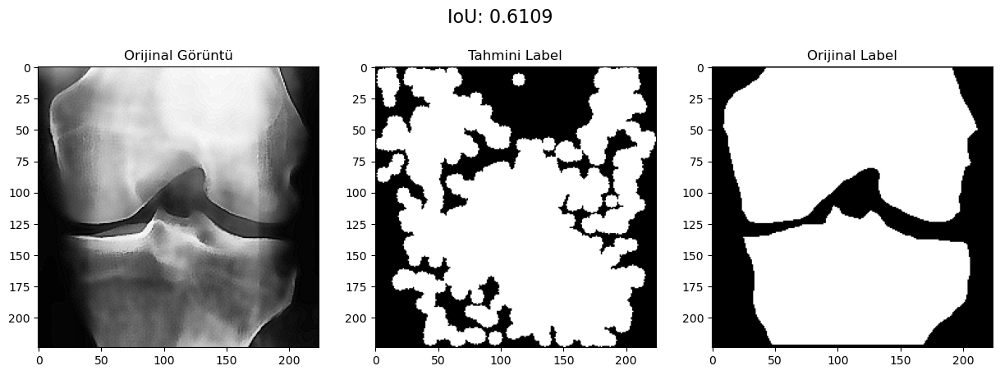

Processing: C:\Users\Eren\Desktop\processed_images\image(5).png


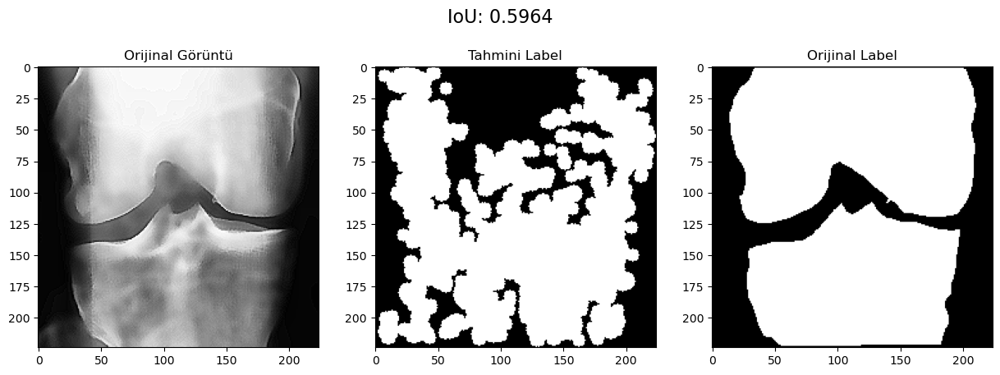

Processing: C:\Users\Eren\Desktop\processed_images\image(6).png


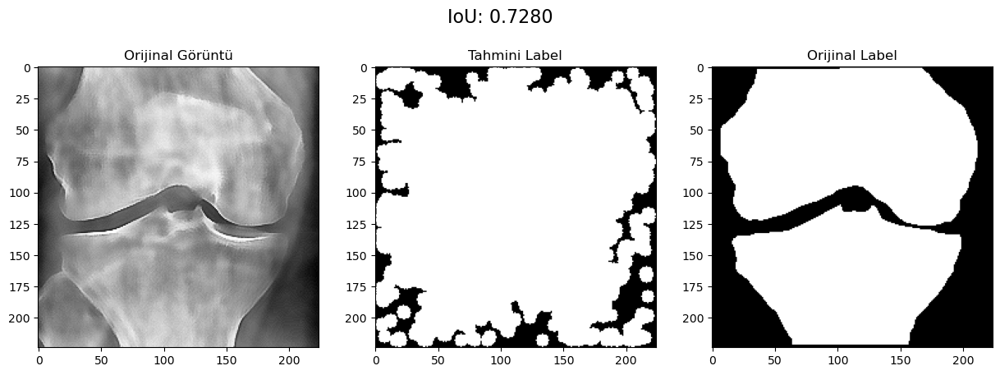

Processing: C:\Users\Eren\Desktop\processed_images\image(7).png


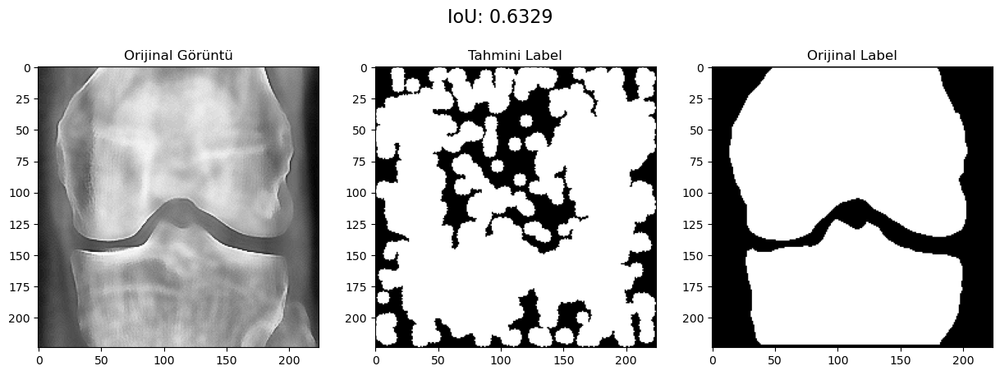

Processing: C:\Users\Eren\Desktop\processed_images\image(8).png


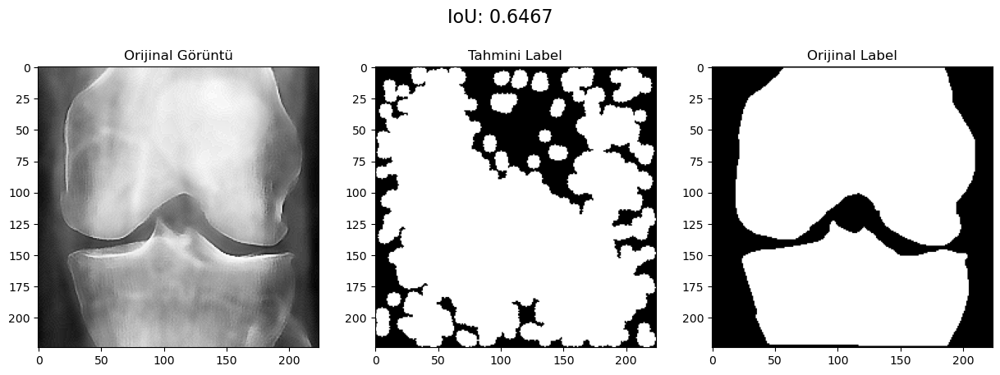

Ortalama IoU: 0.6430


In [3]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog
from joblib import Parallel, delayed
import pickle
from skimage.feature import local_binary_pattern



# LBP uygulama fonksiyonu
def ApplyLBP(img, radius=1, n_points=8):
    lbp = local_binary_pattern(img, n_points, radius, method="uniform")
    lbp_normalized = (lbp / lbp.max() * 255).astype(np.uint8)
    return lbp_normalized

# Normalize ve gri tonlama işlemleri
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# Görüntüden yamalar çıkarma
def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

def ComputeHOG(patch, orientations=9, pixels_per_cell=(8, 8), cells_per_block=(1, 1)):
    if patch.shape[0] < pixels_per_cell[0] or patch.shape[1] < pixels_per_cell[1]:
        return np.zeros(orientations * (cells_per_block[0] * cells_per_block[1]))
    hog_features = hog(
        patch,
        orientations=orientations,
        pixels_per_cell=pixels_per_cell,
        cells_per_block=cells_per_block,
        feature_vector=True,
        visualize=False,
    )
    return hog_features


def MatchHOGVectors(hog_vectors, test_hog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = set(range(len(test_hog_vectors)))  # Başlangıçta tüm test vektörlerini eşleşme adayı olarak kabul et
    for hog_vector in hog_vectors:
        current_matches = set()
        hog_vector = np.array(hog_vector)  # NumPy dizisine dönüştür
        for i, test_vector in enumerate(test_hog_vectors):
            test_vector = np.array(test_vector)  # NumPy dizisine dönüştür
            if similarity_metric == 'cosine':
                norm_avg = np.linalg.norm(hog_vector)
                norm_test = np.linalg.norm(test_vector)
                if norm_avg > 0 and norm_test > 0:
                    similarity = np.dot(test_vector, hog_vector) / (norm_test * norm_avg)
                else:
                    similarity = 0
                distance = 1 - similarity
            elif similarity_metric == 'euclidean':
                distance = np.linalg.norm(test_vector - hog_vector)
            else:
                raise ValueError(f"Unsupported similarity metric: {similarity_metric}")

            if distance < threshold:
                current_matches.add(i)
        matches &= current_matches  # Ortak eşleşmeleri bul
    return list(matches)


# Delikleri doldurma
def fill_holes_with_contours(binary_mask):
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    filled_mask = np.zeros_like(binary_mask)
    for contour in contours:
        cv2.drawContours(filled_mask, [contour], -1, 255, thickness=cv2.FILLED)
    return filled_mask

# IoU hesaplama
def calculate_iou(mask1, mask2):
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    iou = intersection / union if union > 0 else 0
    return iou

# Özellik vektörlerini yükleme
def LoadFeatureVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ortalama IoU hesaplama
def calculate_average_iou(iou_values):
    if len(iou_values) == 0:
        return 0
    return sum(iou_values) / len(iou_values)
# Delikleri doldurma ve morfolojik işlemler uygulama
def refine_mask_with_morphology(binary_mask, kernel_size=5):
    # Yapılandırma elemanı (kernel) oluştur
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

    # Kapama işlemi (Closing: küçük boşlukları kapatır)
    closed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Açma işlemi (Opening: gürültüyü temizler)
    opened_mask = cv2.morphologyEx(closed_mask, cv2.MORPH_OPEN, kernel)

    # Dilasyon (Dilation: nesneleri genişletir)
    dilated_mask = cv2.dilate(opened_mask, kernel, iterations=1)

    return dilated_mask
# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    feature_vectors = LoadFeatureVectors("C:/Users/Eren/Desktop/hog_vektor_kayit/LBP_new_all_hog_vectors.pkl")

    # Test görüntüleri ve etiket yolları
    test_image_paths = [
        r"C:\Users\Eren\Desktop\processed_images\image(4).png",
        r"C:\Users\Eren\Desktop\processed_images\image(5).png",
        r"C:\Users\Eren\Desktop\processed_images\image(6).png",
        r"C:\Users\Eren\Desktop\processed_images\image(7).png",
        r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    ]

    label_paths = [
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(4).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(5).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(6).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(7).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(8).png'
    ]

    iou_values = []

    for test_img_path, label_path in zip(test_image_paths, label_paths):
        print(f"Processing: {test_img_path}")

        test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
        test_img = ConvertAndNormalize(test_img)

        LBPimage = ApplyLBP(test_img)

        # Yamaları oluştur ve özellik vektörlerini çıkar
        test_patches, test_positions = GetPatchesFromImage(LBPimage, patch_size=11, step_size=1)
        test_hog_vectors = Parallel(n_jobs=-1)(delayed(ComputeHOG)(patch) for patch in test_patches)

        # Eşleşen yamaları bul
        matched_indices = MatchHOGVectors(feature_vectors, test_hog_vectors, threshold=0.035,similarity_metric='cosine')
        # İkili maske oluştur
        binary_mask = np.zeros(test_img.shape, dtype=np.uint8)
        for idx in matched_indices:
            y, x = test_positions[idx]
            cv2.circle(binary_mask, (x, y), 5, 255, -1)

        # Delikleri doldur ve morfolojik işlemler uygula
        filled_mask = fill_holes_with_contours(binary_mask)
        refined_mask = refine_mask_with_morphology(binary_mask)

        reference_label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

        if reference_label is None:
            raise FileNotFoundError(f"Referans label bulunamadı: {label_path}")

        # IoU hesapla
        iou = calculate_iou(filled_mask > 0, reference_label > 0)
        iou_values.append(iou)

        # Görselleştirme
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.title("Orijinal Görüntü")
        plt.imshow(test_img, cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title("Tahmini Label")
        plt.imshow(filled_mask, cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title("Orijinal Label")
        plt.imshow(reference_label, cmap='gray')

        plt.suptitle(f"IoU: {iou:.4f}", fontsize=16)
        plt.show()

    # Ortalama IoU hesapla ve yazdır
    average_iou = calculate_average_iou(iou_values)
    print(f"Ortalama IoU: {average_iou:.4f}")

**(2.MADDE) Organ bölgesinden TEK BİR COHOG VEKTÖRÜ üretildi.Test işlemi yapıldı.IoU skorları gösterildi.**

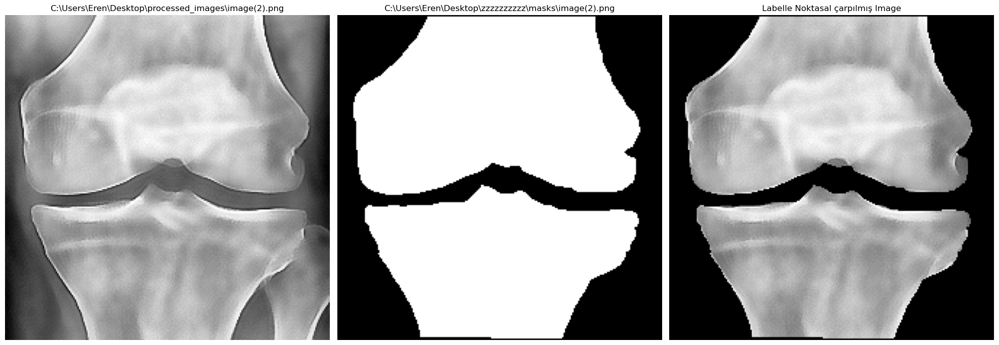

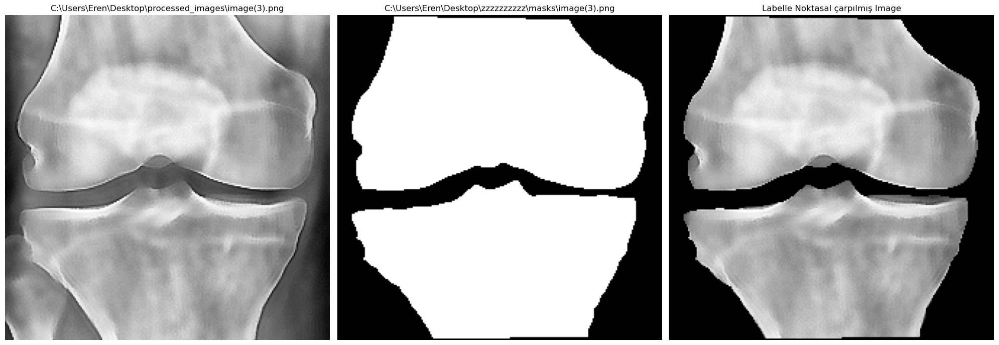

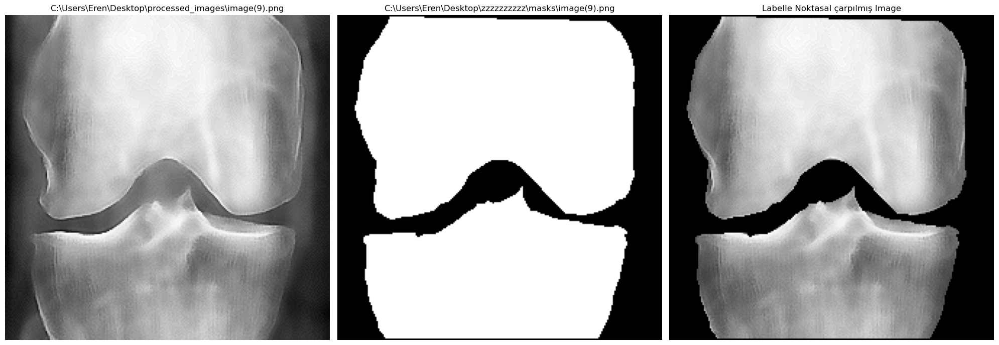

C:\Users\Eren\Desktop\processed_images\image(2).png  Çıkarılan CoHog vektörü: 
CoHoG Vectors: [458.3271941063614, 661.1680012812766, 0.9717175071609991, 0.9592005896615696, 0.33187771468115645, 0.3290309070511804, 0.43687636240595396, 0.4321912305416541]
C:\Users\Eren\Desktop\processed_images\image(3).png  Çıkarılan CoHog vektörü: 
CoHoG Vectors: [406.26049007048715, 625.412075592605, 0.97276008289726, 0.9580658875018147, 0.2887646869644293, 0.28568978174047605, 0.3957571001934292, 0.39589922591184074]
C:\Users\Eren\Desktop\processed_images\image(9).png  Çıkarılan CoHog vektörü: 
CoHoG Vectors: [316.9027866752246, 549.0217408712701, 0.9793577589138084, 0.9642381209217944, 0.2707531588074052, 0.26890654652033974, 0.3924373437337245, 0.4062467358434058]
COHOG vektörleri başarıyla 'C:/Users/Eren/Desktop/cohog_vektor_kayit/cohog_vectors.pkl' konumuna kaydedildi.
Total CoHoG Vectors Shape: 3
Total CoHoG Vectors: [[458.3271941063614, 661.1680012812766, 0.9717175071609991, 0.9592005896615696,

In [7]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from skimage.feature import hog, local_binary_pattern
from skimage import measure
from skimage.feature import graycomatrix, graycoprops
import math
import pickle
from joblib import Parallel, delayed
from hashlib import sha256
import os

# Görüntü normalizasyon fonksiyonu
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

 
def compute_glcm_vector(gray_image):
    """
    Bu fonksiyon gri tonlamalı bir görüntü alır ve GLCM (Gray-Level Co-Occurrence Matrix)
    özelliklerini hesaplar. Özellikler contrast, correlation, energy ve homogeneity içerir.

    Parametre:
    gray_image (ndarray): Gri tonlamalı bir görüntü (0-255 aralığında değerler içerir).

    Returns:
    feature_vector (list): GLCM'den elde edilen özelliklerin bir vektörü.
    """
    # Gri tonlamalı görüntünün uint8 formatında olduğundan emin olun
    if gray_image.max() > 255 or gray_image.min() < 0:
        raise ValueError("Görüntü değerleri 0-255 aralığında olmalıdır.")

    gray_image_uint8 = gray_image.astype(np.uint8)

    # GLCM matrisini hesapla
    glcm = graycomatrix(
        gray_image_uint8, distances=[1], angles=[0, np.pi / 2], symmetric=True, normed=True
    )

    # GLCM özelliklerini hesapla
    contrast = graycoprops(glcm, 'contrast')
    correlation = graycoprops(glcm, 'correlation')
    energy = graycoprops(glcm, 'energy')
    homogeneity = graycoprops(glcm, 'homogeneity')

    # Özellikleri birleştir
    feature_vector = [
        float(contrast[0, 0]), 
        float(contrast[0, 1]),
        float(correlation[0, 0]), 
        float(correlation[0, 1]),
        float(energy[0, 0]), 
        float(energy[0, 1]),
        float(homogeneity[0, 0]), 
        float(homogeneity[0, 1]),
    ]

    return feature_vector


# COHOG vektörlerini bir dosyaya kaydetme
def SaveCOHOGVectors(cohog_vectors, file_path):
    output_dir = os.path.dirname(file_path)
    os.makedirs(output_dir, exist_ok=True)  # Klasör yoksa oluştur
    with open(file_path, 'wb') as file:
        pickle.dump(cohog_vectors, file)
    print(f"COHOG vektörleri başarıyla '{file_path}' konumuna kaydedildi.")

def GetImageLabel(imgStr, labelStr):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    img = ConvertAndNormalize(img)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    label = ConvertAndNormalize(label)

    # Label'i ikili (binary) maske haline getirme
    _, binary_label = cv2.threshold(label, 127, 1, cv2.THRESH_BINARY)

    # Noktasal çarpma işlemi
    masked_image = img * binary_label
    return masked_image ,img ,label

def DisplayImageAndLabel(imgStr, labelStr, maskimage):
    img = cv2.imread(imgStr, cv2.IMREAD_GRAYSCALE)
    label = cv2.imread(labelStr, cv2.IMREAD_GRAYSCALE)
    plt.figure(figsize=(20, 10))

    # Orijinal Görüntü
    plt.subplot(1, 3, 1)
    plt.imshow(img, cmap='gray')
    plt.title(imgStr)
    plt.axis("off")

    # Label Görüntüsü
    plt.subplot(1, 3, 2)
    plt.imshow(label, cmap='gray')
    plt.title(labelStr)
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(maskimage, cmap='gray')
    plt.title("Labelle Noktasal çarpılmış Image")
    plt.axis("off")

    plt.tight_layout()
    plt.show()


# Ana akış
if __name__ == "__main__":
    # Çoklu görüntü ve etiket dosya yolları
    image_paths = [r"C:\Users\Eren\Desktop\processed_images\image(2).png", 
                   r"C:\Users\Eren\Desktop\processed_images\image(3).png",
                   r"C:\Users\Eren\Desktop\processed_images\image(9).png"]
    
    label_paths = [r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(2).png", 
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(3).png",
                   r"C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(9).png" ]

    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)
        DisplayImageAndLabel(img_path, label_path, maskedimg)

    all_cohog_vectors = []
        
    for img_path, label_path in zip(image_paths, label_paths):
        # Görüntü ve etiketleri yükle
        maskedimg, img, label = GetImageLabel(img_path, label_path)
       
        #Her gorselde organ bolgesinden cohog vektoru uret
        cohog_vectors = compute_glcm_vector(maskedimg)

        all_cohog_vectors.append(cohog_vectors)
        print(img_path," Çıkarılan CoHog vektörü: ")
        print("CoHoG Vectors:", cohog_vectors)
        
    
    # Tüm HOG vektörlerini bir dosyaya kaydet
    SaveCOHOGVectors(all_cohog_vectors, "C:/Users/Eren/Desktop/cohog_vektor_kayit/cohog_vectors.pkl")

    print("Total CoHoG Vectors Shape:", len(all_cohog_vectors))
    print("Total CoHoG Vectors:", all_cohog_vectors)


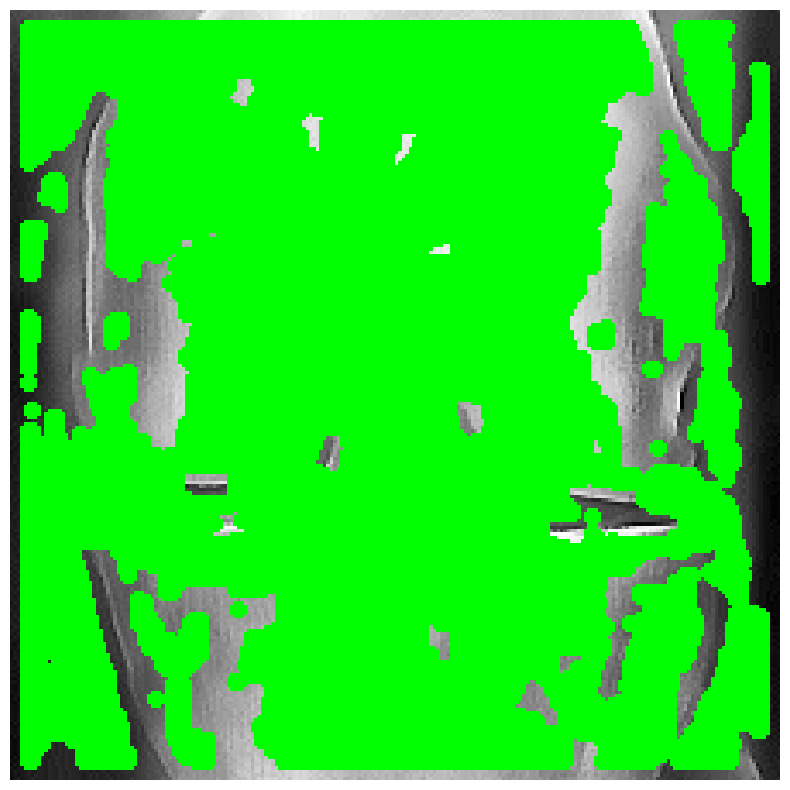

Total test patches extracted: 45796
Total matched patches: 29940


In [12]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pickle
from joblib import Parallel, delayed
from skimage.feature.texture import graycomatrix, graycoprops

def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

def compute_glcm_vector(gray_image):
    """
    Bu fonksiyon gri tonlamalı bir görüntü alır ve GLCM (Gray-Level Co-Occurrence Matrix)
    özelliklerini hesaplar. Özellikler contrast, correlation, energy ve homogeneity içerir.

    Parametre:
    gray_image (ndarray): Gri tonlamalı bir görüntü (0-255 aralığında değerler içerir).

    Returns:
    feature_vector (list): GLCM'den elde edilen özelliklerin bir vektörü.
    """
    # Gri tonlamalı görüntünün uint8 formatında olduğundan emin olun
    if gray_image.max() > 255 or gray_image.min() < 0:
        raise ValueError("Görüntü değerleri 0-255 aralığında olmalıdır.")

    gray_image_uint8 = gray_image.astype(np.uint8)

    # GLCM matrisini hesapla
    glcm = graycomatrix(
        gray_image_uint8, distances=[1], angles=[0, np.pi / 2], symmetric=True, normed=True
    )

    # GLCM özelliklerini hesapla
    contrast = graycoprops(glcm, 'contrast')
    correlation = graycoprops(glcm, 'correlation')
    energy = graycoprops(glcm, 'energy')
    homogeneity = graycoprops(glcm, 'homogeneity')

    # Özellikleri birleştir
    feature_vector = [
        float(contrast[0, 0]), 
        float(contrast[0, 1]),
        float(correlation[0, 0]), 
        float(correlation[0, 1]),
        float(energy[0, 0]), 
        float(energy[0, 1]),
        float(homogeneity[0, 0]), 
        float(homogeneity[0, 1]),
    ]

    return feature_vector


def MatchCOHOGVectors(cohog_vectors, test_cohog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = set(range(len(test_cohog_vectors)))  # Başlangıçta tüm test vektörlerini eşleşme adayı olarak kabul et
    for cohog_vector in cohog_vectors:
        current_matches = set()
        cohog_vector = np.array(cohog_vector)  # NumPy dizisine dönüştür
        for i, test_vector in enumerate(test_cohog_vectors):
            test_vector = np.array(test_vector)  # NumPy dizisine dönüştür
            if similarity_metric == 'cosine':
                norm_avg = np.linalg.norm(cohog_vector)
                norm_test = np.linalg.norm(test_vector)
                if norm_avg > 0 and norm_test > 0:
                    similarity = np.dot(test_vector, cohog_vector) / (norm_test * norm_avg)
                else:
                    similarity = 0
                distance = 1 - similarity
            elif similarity_metric == 'euclidean':
                distance = np.linalg.norm(test_vector - cohog_vector)
            else:
                raise ValueError(f"Unsupported similarity metric: {similarity_metric}")

            if distance < threshold:
                current_matches.add(i)
        matches &= current_matches  # Ortak eşleşmeleri bul
    return list(matches)

def DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=11):
    half_patch = patch_size // 2
    output_img = cv2.cvtColor(test_img, cv2.COLOR_GRAY2BGR)
    for idx in matched_indices:
        y, x = test_positions[idx]
        cv2.rectangle(output_img, (x - half_patch, y - half_patch), (x + half_patch, y + half_patch), (0, 255, 0), 2)
    plt.figure(figsize=(10, 10))
    plt.imshow(cv2.cvtColor(output_img, cv2.COLOR_BGR2RGB))
    plt.axis('off')
    plt.show()

def LoadAverageCOHOGVector(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ana akış
if __name__ == "__main__":
    cohog_vector_path = "C:/Users/Eren/Desktop/cohog_vektor_kayit/cohog_vectors.pkl"
    cohog_vector = LoadAverageCOHOGVector(cohog_vector_path)

    test_img_path = r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
    test_img = ConvertAndNormalize(test_img)

    test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)

    # Paralel GLCM hesaplamaları
    test_cohog_vectors = Parallel(n_jobs=-1)(delayed(compute_glcm_vector)(patch) for patch in test_patches)

    matched_indices = MatchCOHOGVectors(cohog_vector, test_cohog_vectors, threshold=0.1, similarity_metric='cosine')

    DisplayMatchedPatches(test_img, test_positions, matched_indices, patch_size=2)

    print("Total test patches extracted:", len(test_patches))
    print("Total matched patches:", len(matched_indices))

Processing: C:\Users\Eren\Desktop\processed_images\image(4).png


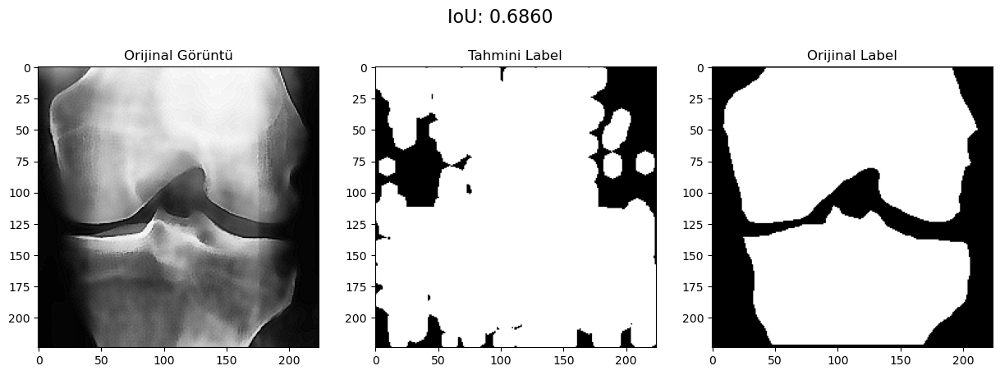

Processing: C:\Users\Eren\Desktop\processed_images\image(5).png


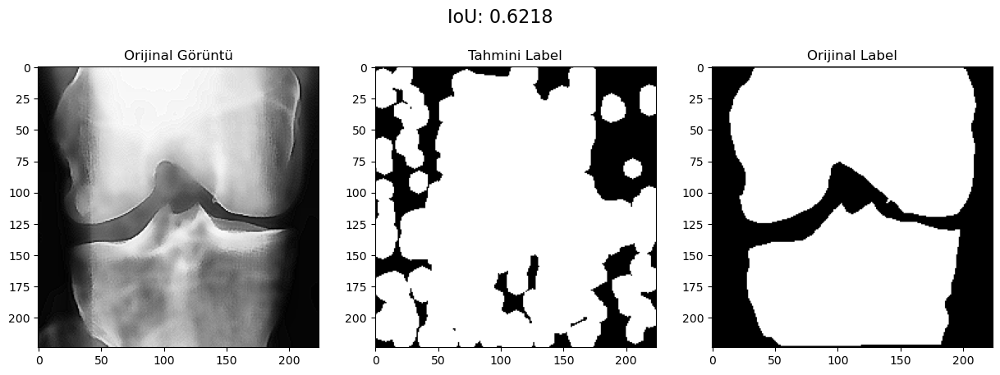

Processing: C:\Users\Eren\Desktop\processed_images\image(6).png


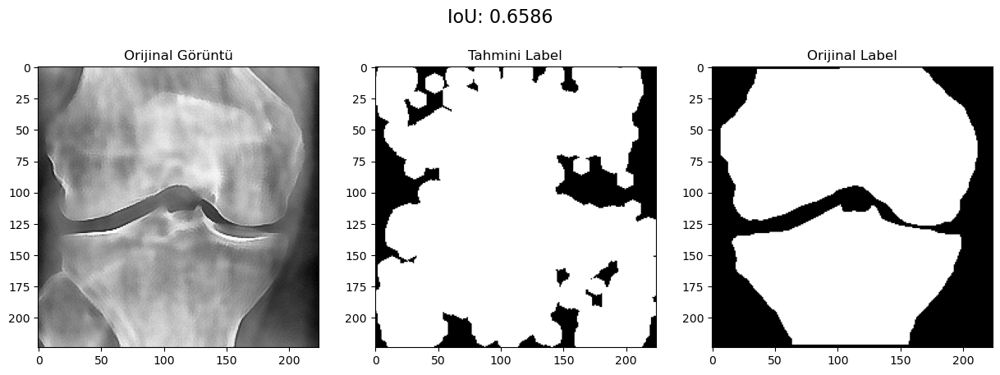

Processing: C:\Users\Eren\Desktop\processed_images\image(7).png


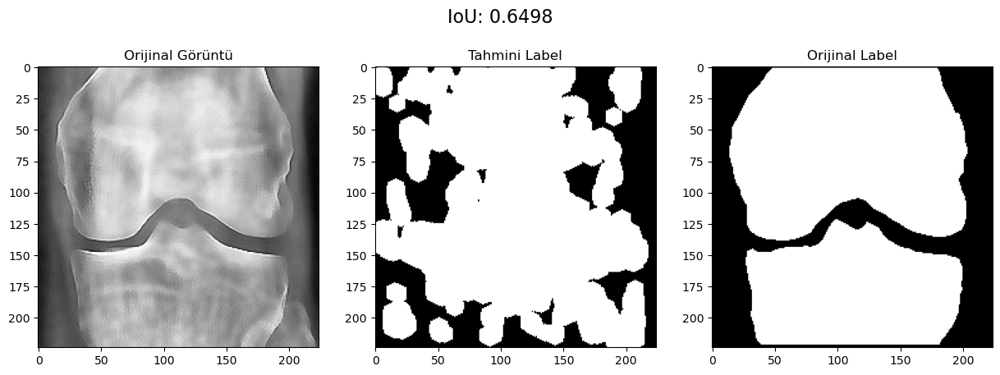

Processing: C:\Users\Eren\Desktop\processed_images\image(8).png


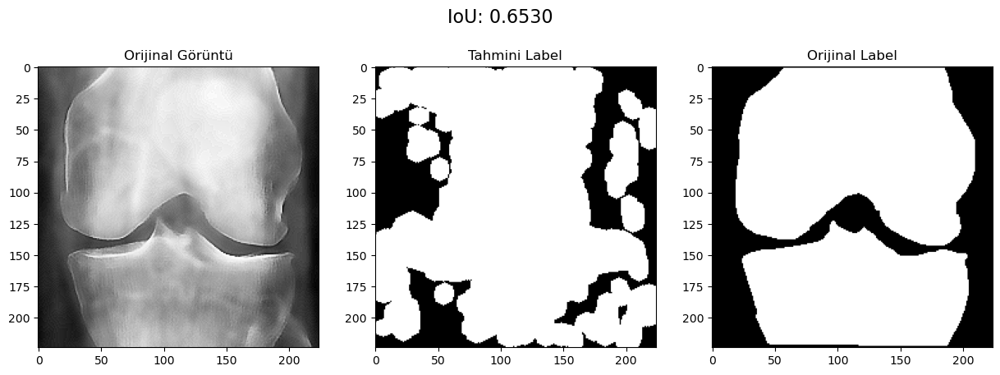

Ortalama IoU: 0.6538


In [16]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
from joblib import Parallel, delayed
import pickle
from skimage.feature.texture import graycomatrix, graycoprops


# Normalize ve gri tonlama işlemleri
def ConvertAndNormalize(img):
    if len(img.shape) == 3 and img.shape[2] == 3:
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    min_val = np.min(img)
    max_val = np.max(img)
    normalized_img = ((img - min_val) / (max_val - min_val) * 255).astype(np.uint8)
    return normalized_img

# Görüntüden yamalar çıkarma
def GetPatchesFromImage(img, patch_size=11, step_size=2):
    half_patch = patch_size // 2
    patches = []
    positions = []
    for y in range(half_patch, img.shape[0] - half_patch, step_size):
        for x in range(half_patch, img.shape[1] - half_patch, step_size):
            patch = img[y - half_patch:y + half_patch + 1, x - half_patch:x + half_patch + 1]
            patches.append(patch)
            positions.append((y, x))
    return patches, positions

# COHOG özellik vektörlerini çıkarma
def compute_glcm_vector(gray_image):
    """
    Bu fonksiyon gri tonlamalı bir görüntü alır ve GLCM (Gray-Level Co-Occurrence Matrix)
    özelliklerini hesaplar. Özellikler contrast, correlation, energy ve homogeneity içerir.

    Parametre:
    gray_image (ndarray): Gri tonlamalı bir görüntü (0-255 aralığında değerler içerir).

    Returns:
    feature_vector (list): GLCM'den elde edilen özelliklerin bir vektörü.
    """
    # Gri tonlamalı görüntünün uint8 formatında olduğundan emin olun
    if gray_image.max() > 255 or gray_image.min() < 0:
        raise ValueError("Görüntü değerleri 0-255 aralığında olmalıdır.")

    gray_image_uint8 = gray_image.astype(np.uint8)

    # GLCM matrisini hesapla
    glcm = graycomatrix(
        gray_image_uint8, distances=[1], angles=[0, np.pi / 2], symmetric=True, normed=True
    )

    # GLCM özelliklerini hesapla
    contrast = graycoprops(glcm, 'contrast')
    correlation = graycoprops(glcm, 'correlation')
    energy = graycoprops(glcm, 'energy')
    homogeneity = graycoprops(glcm, 'homogeneity')

    # Özellikleri birleştir
    feature_vector = [
        float(contrast[0, 0]), 
        float(contrast[0, 1]),
        float(correlation[0, 0]), 
        float(correlation[0, 1]),
        float(energy[0, 0]), 
        float(energy[0, 1]),
        float(homogeneity[0, 0]), 
        float(homogeneity[0, 1]),
    ]

    return feature_vector


# COHOG vektör eşleşmelerini bulma
def MatchCOHOGVectors(cohog_vectors, test_cohog_vectors, threshold=0.038, similarity_metric='cosine'):
    matches = set(range(len(test_cohog_vectors)))  # Başlangıçta tüm test vektörlerini eşleşme adayı olarak kabul et
    for cohog_vector in cohog_vectors:
        current_matches = set()
        cohog_vector = np.array(cohog_vector)  # NumPy dizisine dönüştür
        for i, test_vector in enumerate(test_cohog_vectors):
            test_vector = np.array(test_vector)  # NumPy dizisine dönüştür
            if similarity_metric == 'cosine':
                norm_avg = np.linalg.norm(cohog_vector)
                norm_test = np.linalg.norm(test_vector)
                if norm_avg > 0 and norm_test > 0:
                    similarity = np.dot(test_vector, cohog_vector) / (norm_test * norm_avg)
                else:
                    similarity = 0
                distance = 1 - similarity
            elif similarity_metric == 'euclidean':
                distance = np.linalg.norm(test_vector - cohog_vector)
            else:
                raise ValueError(f"Unsupported similarity metric: {similarity_metric}")

            if distance < threshold:
                current_matches.add(i)
        matches &= current_matches  # Ortak eşleşmeleri bul
    return list(matches)


# Delikleri doldurma
def fill_holes_with_contours(binary_mask):
    contours, _ = cv2.findContours(binary_mask, cv2.RETR_CCOMP, cv2.CHAIN_APPROX_SIMPLE)
    filled_mask = np.zeros_like(binary_mask)
    for contour in contours:
        cv2.drawContours(filled_mask, [contour], -1, 255, thickness=cv2.FILLED)
    return filled_mask

# IoU hesaplama
def calculate_iou(mask1, mask2):
    intersection = np.logical_and(mask1, mask2).sum()
    union = np.logical_or(mask1, mask2).sum()
    iou = intersection / union if union > 0 else 0
    return iou

# Özellik vektörlerini yükleme
def LoadFeatureVectors(file_path):
    with open(file_path, 'rb') as file:
        return pickle.load(file)

# Ortalama IoU hesaplama
def calculate_average_iou(iou_values):
    if len(iou_values) == 0:
        return 0
    return sum(iou_values) / len(iou_values)
# Delikleri doldurma ve morfolojik işlemler uygulama
def refine_mask_with_morphology(binary_mask, kernel_size=5):
    # Yapılandırma elemanı (kernel) oluştur
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (kernel_size, kernel_size))

    # Kapama işlemi (Closing: küçük boşlukları kapatır)
    closed_mask = cv2.morphologyEx(binary_mask, cv2.MORPH_CLOSE, kernel)

    # Açma işlemi (Opening: gürültüyü temizler)
    opened_mask = cv2.morphologyEx(closed_mask, cv2.MORPH_OPEN, kernel)

    # Dilasyon (Dilation: nesneleri genişletir)
    dilated_mask = cv2.dilate(opened_mask, kernel, iterations=1)

    return dilated_mask
# Ana akış
if __name__ == "__main__":
    # Kaydedilmiş HOG vektörlerini yükle
    feature_vectors = LoadFeatureVectors("C:/Users/Eren/Desktop/cohog_vektor_kayit/cohog_vectors.pkl")

    # Test görüntüleri ve etiket yolları
    test_image_paths = [
        r"C:\Users\Eren\Desktop\processed_images\image(4).png",
        r"C:\Users\Eren\Desktop\processed_images\image(5).png",
        r"C:\Users\Eren\Desktop\processed_images\image(6).png",
        r"C:\Users\Eren\Desktop\processed_images\image(7).png",
        r"C:\Users\Eren\Desktop\processed_images\image(8).png"
    ]

    label_paths = [
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(4).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(5).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(6).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(7).png',
        r'C:\Users\Eren\Desktop\zzzzzzzzzz\masks\image(8).png'
    ]

    iou_values = []

    for test_img_path, label_path in zip(test_image_paths, label_paths):
        print(f"Processing: {test_img_path}")

        test_img = cv2.imread(test_img_path, cv2.IMREAD_GRAYSCALE)
        test_img = ConvertAndNormalize(test_img)

        # Yamaları oluştur ve özellik vektörlerini çıkar
        test_patches, test_positions = GetPatchesFromImage(test_img, patch_size=11, step_size=1)
        test_cohog_vectors = Parallel(n_jobs=-1)(delayed(compute_glcm_vector)(patch) for patch in test_patches)

        # Eşleşen yamaları bul
        matched_indices = MatchCOHOGVectors(feature_vectors, test_cohog_vectors, threshold=0.04,similarity_metric='cosine')
        # İkili maske oluştur
        binary_mask = np.zeros(test_img.shape, dtype=np.uint8)
        for idx in matched_indices:
            y, x = test_positions[idx]
            cv2.circle(binary_mask, (x, y), 5, 255, -1)

        # Delikleri doldur ve morfolojik işlemler uygula
        filled_mask = fill_holes_with_contours(binary_mask)
        refined_mask = refine_mask_with_morphology(filled_mask)

        reference_label = cv2.imread(label_path, cv2.IMREAD_GRAYSCALE)

        if reference_label is None:
            raise FileNotFoundError(f"Referans label bulunamadı: {label_path}")

        # IoU hesapla
        iou = calculate_iou(refined_mask > 0, reference_label > 0)
        iou_values.append(iou)

        # Görselleştirme
        plt.figure(figsize=(15, 5))
        plt.subplot(1, 3, 1)
        plt.title("Orijinal Görüntü")
        plt.imshow(test_img, cmap='gray')

        plt.subplot(1, 3, 2)
        plt.title("Tahmini Label")
        plt.imshow(refined_mask, cmap='gray')

        plt.subplot(1, 3, 3)
        plt.title("Orijinal Label")
        plt.imshow(reference_label, cmap='gray')

        plt.suptitle(f"IoU: {iou:.4f}", fontsize=16)
        plt.show()

    # Ortalama IoU hesapla ve yazdır
    average_iou = calculate_average_iou(iou_values)
    print(f"Ortalama IoU: {average_iou:.4f}")